In [1]:
# Install PyTorch and Torchvision (if not pre-installed)
!pip install torch torchvision

# Install additional libraries
!pip install matplotlib Pillow scikit-learn


In [2]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import os
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [3]:
# Dataset Definition
class TreeDataset(Dataset):
    def __init__(self, normal_dir, decorated_dir, indices=None, transform=None):
        self.normal_paths = sorted([os.path.join(normal_dir, img) for img in os.listdir(normal_dir)])
        self.decorated_paths = sorted([os.path.join(decorated_dir, img) for img in os.listdir(decorated_dir)])
        if indices is not None:
            self.normal_paths = [self.normal_paths[i] for i in indices]
            self.decorated_paths = [self.decorated_paths[i] for i in indices]
        self.transform = transform

    def __len__(self):
        return len(self.normal_paths)

    def __getitem__(self, idx):
        normal_image = Image.open(self.normal_paths[idx]).convert('RGB')
        decorated_image = Image.open(self.decorated_paths[idx]).convert('RGB')
        if self.transform:
            normal_image = self.transform(normal_image)
            decorated_image = self.transform(decorated_image)
        return normal_image, decorated_image


In [4]:
# Residual Block Definition
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1),
            nn.InstanceNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1),
            nn.InstanceNorm2d(channels),
        )

    def forward(self, x):
        return x + self.block(x)

# Generator with Residual Blocks
class GeneratorResNet(nn.Module):
    def __init__(self, input_channels=3, output_channels=3, num_residuals=9):
        super(GeneratorResNet, self).__init__()
        self.initial = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=7, stride=1, padding=3),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True),
        )
        self.downsampling = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.InstanceNorm2d(256),
            nn.ReLU(inplace=True),
        )
        self.residuals = nn.Sequential(*[ResidualBlock(256) for _ in range(num_residuals)])
        self.upsampling = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True),
        )
        self.output = nn.Sequential(
            nn.Conv2d(64, output_channels, kernel_size=7, stride=1, padding=3),
            nn.Tanh(),
        )

    def forward(self, x):
        x = self.initial(x)
        x = self.downsampling(x)
        x = self.residuals(x)
        x = self.upsampling(x)
        return self.output(x)

# Discriminator Definition (PatchGAN)
class Discriminator(nn.Module):
    def __init__(self, input_channels=3):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1),
        )

    def forward(self, x):
        return self.model(x)


In [5]:
def train_cyclegan(generator_g, generator_f, discriminator_x, discriminator_y, train_loader, val_loader, device, num_epochs=100):
    opt_g = torch.optim.Adam(list(generator_g.parameters()) + list(generator_f.parameters()), lr=1e-4, betas=(0.5, 0.999))
    opt_d_x = torch.optim.Adam(discriminator_x.parameters(), lr=1e-4, betas=(0.5, 0.999))
    opt_d_y = torch.optim.Adam(discriminator_y.parameters(), lr=1e-4, betas=(0.5, 0.999))

    mse_loss = nn.MSELoss()
    l1_loss = nn.L1Loss()

    for epoch in range(num_epochs):
        generator_g.train()
        generator_f.train()

        total_loss_g, total_loss_d_x, total_loss_d_y = 0, 0, 0

        for normal, decorated in train_loader:
            normal = normal.to(device)
            decorated = decorated.to(device)

            # Train Generators
            opt_g.zero_grad()
            fake_decorated = generator_g(normal)
            fake_normal = generator_f(decorated)

            loss_g_adv = mse_loss(discriminator_y(fake_decorated), torch.ones_like(discriminator_y(fake_decorated)))
            cycle_normal = generator_f(fake_decorated)
            cycle_decorated = generator_g(fake_normal)
            loss_cycle = l1_loss(cycle_normal, normal) + l1_loss(cycle_decorated, decorated)

            loss_g = loss_g_adv + 10 * loss_cycle
            loss_g.backward()
            opt_g.step()

            # Train Discriminators
            opt_d_x.zero_grad()
            opt_d_y.zero_grad()

            loss_d_x_real = mse_loss(discriminator_x(decorated), torch.ones_like(discriminator_x(decorated)))
            loss_d_x_fake = mse_loss(discriminator_x(fake_decorated.detach()), torch.zeros_like(discriminator_x(fake_decorated.detach())))
            loss_d_x = (loss_d_x_real + loss_d_x_fake) * 0.5

            loss_d_y_real = mse_loss(discriminator_y(normal), torch.ones_like(discriminator_y(normal)))
            loss_d_y_fake = mse_loss(discriminator_y(fake_normal.detach()), torch.zeros_like(discriminator_y(fake_normal.detach())))
            loss_d_y = (loss_d_y_real + loss_d_y_fake) * 0.5

            loss_d_x.backward()
            loss_d_y.backward()
            opt_d_x.step()
            opt_d_y.step()

            total_loss_g += loss_g.item()
            total_loss_d_x += loss_d_x.item()
            total_loss_d_y += loss_d_y.item()

        # Show Images
        if (epoch + 1) % 10 == 0:
            generator_g.eval()
            generator_f.eval()
            with torch.no_grad():
                for i, (normal, decorated) in enumerate(val_loader):
                    if i >= 3:
                        break

                    normal = normal.to(device)
                    decorated = decorated.to(device)

                    fake_decorated = generator_g(normal)
                    fake_normal = generator_f(decorated)

                    normal_np = normal[0].permute(1, 2, 0).cpu().numpy()
                    decorated_np = decorated[0].permute(1, 2, 0).cpu().numpy()
                    fake_decorated_np = fake_decorated[0].permute(1, 2, 0).cpu().numpy()
                    fake_normal_np = fake_normal[0].permute(1, 2, 0).cpu().numpy()

                    fig, axs = plt.subplots(1, 4, figsize=(15, 5))
                    axs[0].imshow((normal_np + 1) / 2)
                    axs[0].set_title("Normal Tree")
                    axs[1].imshow((decorated_np + 1) / 2)
                    axs[1].set_title("Decorated Tree")
                    axs[2].imshow((fake_decorated_np + 1) / 2)
                    axs[2].set_title("Fake Decorated Tree")
                    axs[3].imshow((fake_normal_np + 1) / 2)
                    axs[3].set_title("Fake Normal Tree")
                    plt.show()

        print(f"Epoch [{epoch+1}/{num_epochs}] Loss G: {total_loss_g:.4f}, Loss D_x: {total_loss_d_x:.4f}, Loss D_y: {total_loss_d_y:.4f}")

Epoch [1/300] Loss G: 427.1098, Loss D_x: 10.5201, Loss D_y: 13.3516
Epoch [2/300] Loss G: 323.7546, Loss D_x: 4.1052, Loss D_y: 5.4027
Epoch [3/300] Loss G: 280.0277, Loss D_x: 7.4826, Loss D_y: 2.8105
Epoch [4/300] Loss G: 251.7308, Loss D_x: 1.4335, Loss D_y: 2.3845
Epoch [5/300] Loss G: 240.9690, Loss D_x: 1.2373, Loss D_y: 2.2946
Epoch [6/300] Loss G: 221.2732, Loss D_x: 1.0863, Loss D_y: 1.5099
Epoch [7/300] Loss G: 222.4522, Loss D_x: 1.2144, Loss D_y: 1.5521
Epoch [8/300] Loss G: 207.7647, Loss D_x: 1.4109, Loss D_y: 1.0784
Epoch [9/300] Loss G: 202.6352, Loss D_x: 1.0078, Loss D_y: 1.1039


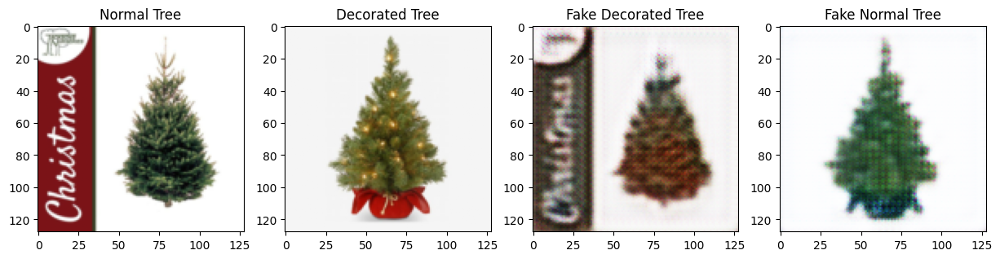

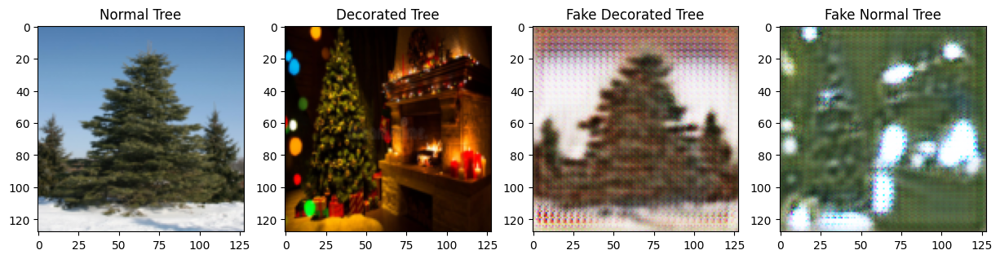

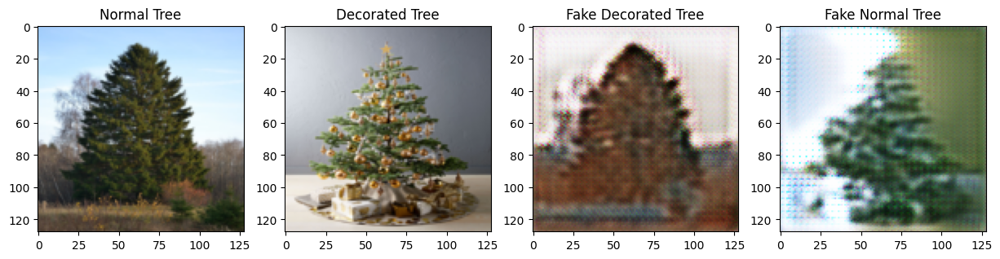

Epoch [10/300] Loss G: 191.5626, Loss D_x: 0.7084, Loss D_y: 0.9062
Epoch [11/300] Loss G: 190.9145, Loss D_x: 0.8430, Loss D_y: 0.7244
Epoch [12/300] Loss G: 184.1731, Loss D_x: 0.7845, Loss D_y: 0.6223
Epoch [13/300] Loss G: 180.3685, Loss D_x: 0.7938, Loss D_y: 0.7413
Epoch [14/300] Loss G: 182.0168, Loss D_x: 0.6588, Loss D_y: 0.6928
Epoch [15/300] Loss G: 172.7203, Loss D_x: 0.4174, Loss D_y: 0.7841
Epoch [16/300] Loss G: 173.2475, Loss D_x: 0.9208, Loss D_y: 0.4712
Epoch [17/300] Loss G: 166.0546, Loss D_x: 1.5913, Loss D_y: 0.3651
Epoch [18/300] Loss G: 161.0974, Loss D_x: 0.3867, Loss D_y: 0.6327
Epoch [19/300] Loss G: 195.7955, Loss D_x: 0.4539, Loss D_y: 26.4321


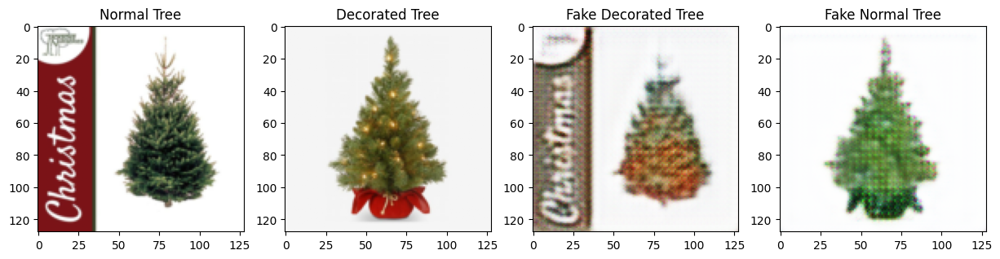

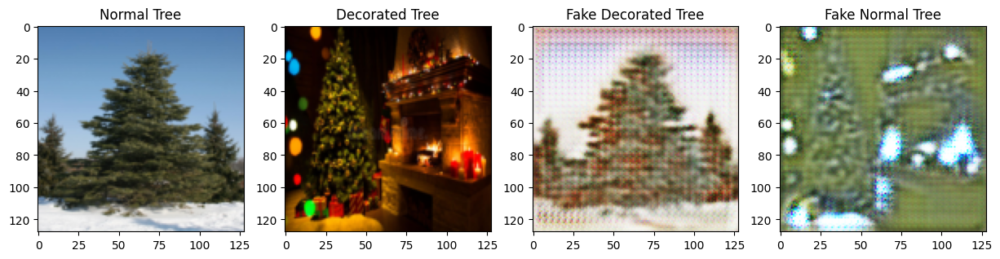

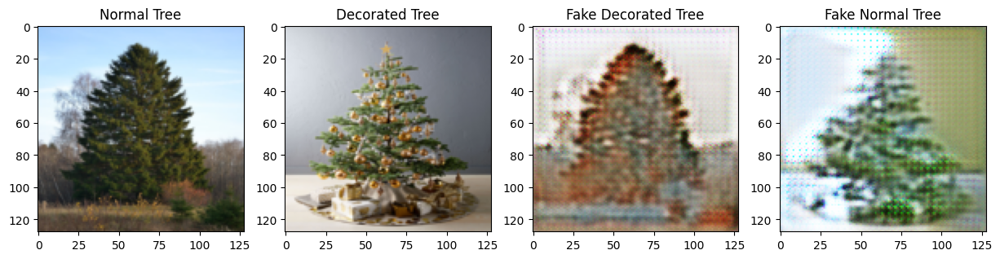

Epoch [20/300] Loss G: 160.8531, Loss D_x: 0.2307, Loss D_y: 2.2800
Epoch [21/300] Loss G: 157.7011, Loss D_x: 0.2202, Loss D_y: 0.7662
Epoch [22/300] Loss G: 150.9197, Loss D_x: 0.2165, Loss D_y: 0.5039
Epoch [23/300] Loss G: 151.5063, Loss D_x: 0.2723, Loss D_y: 0.3572
Epoch [24/300] Loss G: 154.9435, Loss D_x: 0.2331, Loss D_y: 0.3192
Epoch [25/300] Loss G: 147.3669, Loss D_x: 0.2741, Loss D_y: 0.3068
Epoch [26/300] Loss G: 147.3061, Loss D_x: 0.5680, Loss D_y: 0.2369
Epoch [27/300] Loss G: 145.1391, Loss D_x: 0.8635, Loss D_y: 0.2570
Epoch [28/300] Loss G: 140.8114, Loss D_x: 2.3503, Loss D_y: 0.1993
Epoch [29/300] Loss G: 139.6577, Loss D_x: 0.2780, Loss D_y: 0.1823


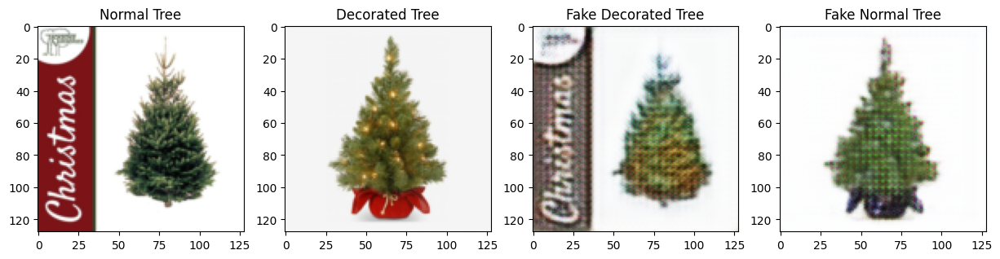

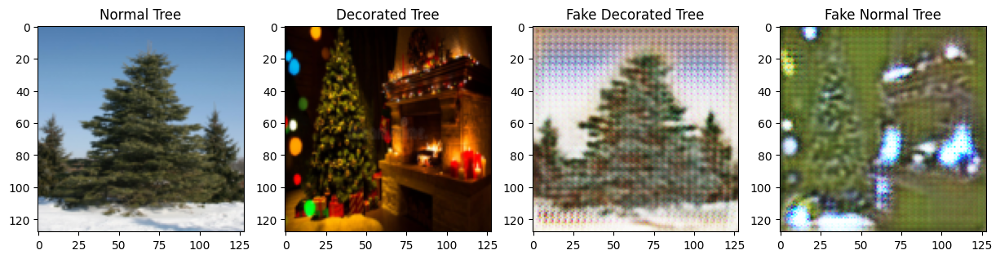

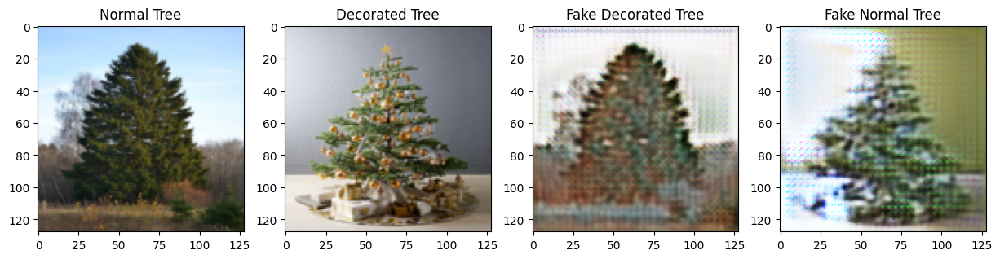

Epoch [30/300] Loss G: 138.6621, Loss D_x: 0.1884, Loss D_y: 0.2130
Epoch [31/300] Loss G: 138.6491, Loss D_x: 0.1961, Loss D_y: 0.2216
Epoch [32/300] Loss G: 136.9177, Loss D_x: 0.1351, Loss D_y: 0.1951
Epoch [33/300] Loss G: 133.0401, Loss D_x: 0.1307, Loss D_y: 0.1625
Epoch [34/300] Loss G: 135.6452, Loss D_x: 0.1573, Loss D_y: 0.1747
Epoch [35/300] Loss G: 133.4643, Loss D_x: 0.1271, Loss D_y: 0.1975
Epoch [36/300] Loss G: 129.7121, Loss D_x: 0.1160, Loss D_y: 0.1712
Epoch [37/300] Loss G: 133.9537, Loss D_x: 0.1366, Loss D_y: 0.1609
Epoch [38/300] Loss G: 132.6713, Loss D_x: 0.1254, Loss D_y: 0.2292
Epoch [39/300] Loss G: 127.9425, Loss D_x: 0.1419, Loss D_y: 0.1172


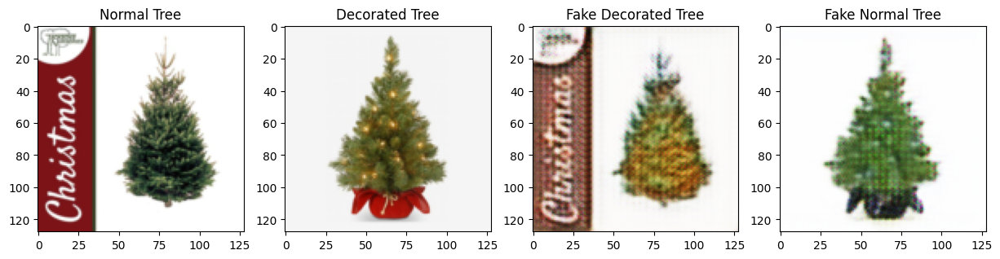

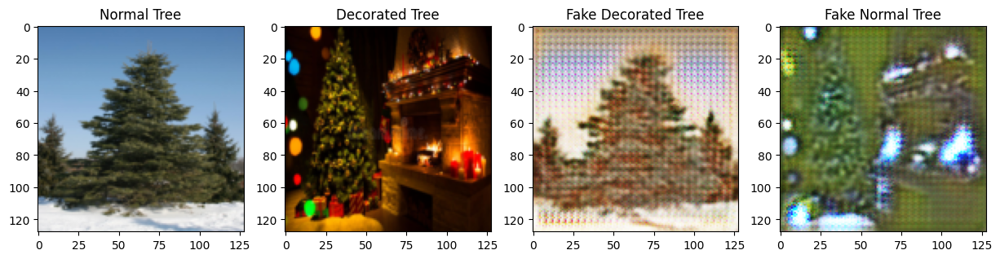

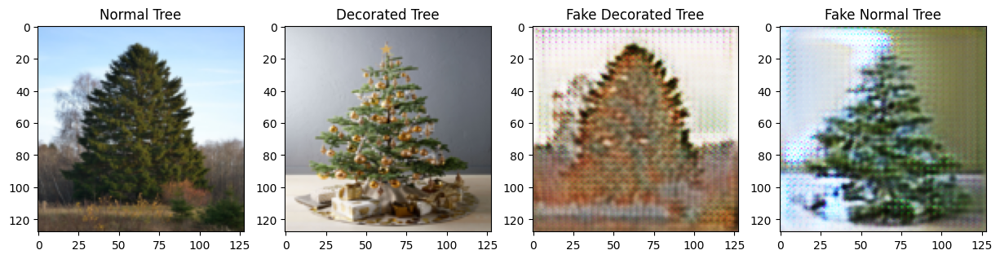

Epoch [40/300] Loss G: 128.7289, Loss D_x: 0.1342, Loss D_y: 0.1279
Epoch [41/300] Loss G: 126.7005, Loss D_x: 0.1306, Loss D_y: 0.2768
Epoch [42/300] Loss G: 122.7424, Loss D_x: 0.1915, Loss D_y: 0.1145
Epoch [43/300] Loss G: 126.2415, Loss D_x: 0.1470, Loss D_y: 0.1036
Epoch [44/300] Loss G: 122.6888, Loss D_x: 0.1520, Loss D_y: 0.1850
Epoch [45/300] Loss G: 121.2986, Loss D_x: 0.2108, Loss D_y: 0.1412
Epoch [46/300] Loss G: 122.5628, Loss D_x: 0.5438, Loss D_y: 0.1403
Epoch [47/300] Loss G: 125.9182, Loss D_x: 0.1319, Loss D_y: 0.1135
Epoch [48/300] Loss G: 119.3163, Loss D_x: 0.1190, Loss D_y: 0.2161
Epoch [49/300] Loss G: 120.9845, Loss D_x: 0.1233, Loss D_y: 0.1599


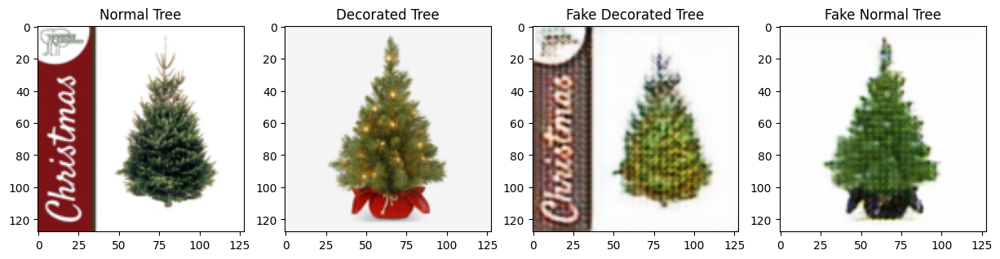

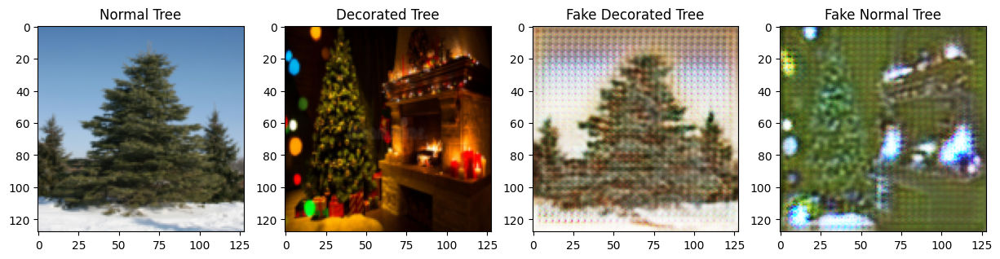

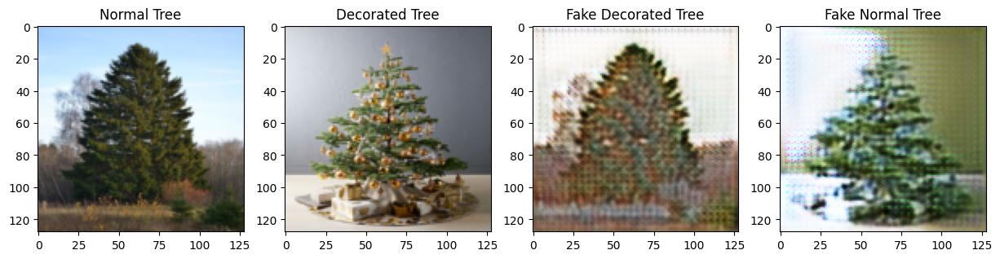

Epoch [50/300] Loss G: 118.3710, Loss D_x: 0.1167, Loss D_y: 0.1596
Epoch [51/300] Loss G: 117.1385, Loss D_x: 0.1095, Loss D_y: 0.1463
Epoch [52/300] Loss G: 117.5960, Loss D_x: 0.1452, Loss D_y: 0.1459
Epoch [53/300] Loss G: 115.7246, Loss D_x: 0.0950, Loss D_y: 0.1195
Epoch [54/300] Loss G: 115.3420, Loss D_x: 0.1019, Loss D_y: 0.1593
Epoch [55/300] Loss G: 115.3825, Loss D_x: 0.2120, Loss D_y: 0.0742
Epoch [56/300] Loss G: 125.5651, Loss D_x: 0.1348, Loss D_y: 13.7042
Epoch [57/300] Loss G: 116.3322, Loss D_x: 0.1698, Loss D_y: 0.6476
Epoch [58/300] Loss G: 114.0747, Loss D_x: 0.1279, Loss D_y: 0.3288
Epoch [59/300] Loss G: 110.7574, Loss D_x: 0.1132, Loss D_y: 0.2434


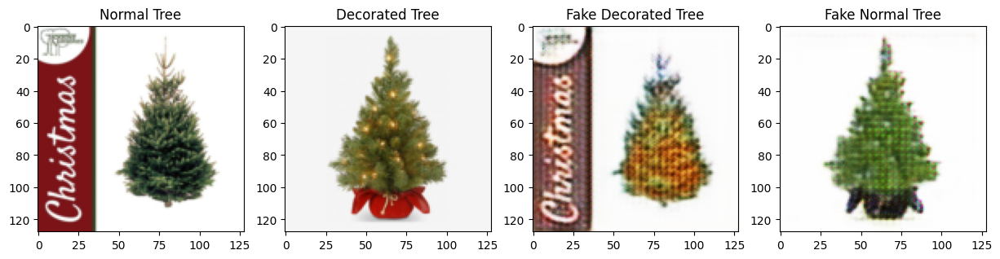

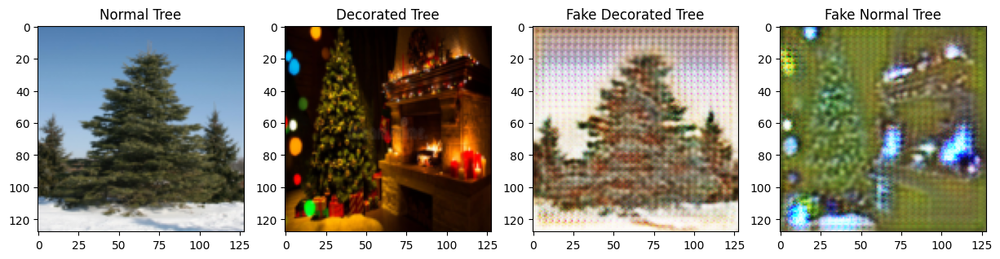

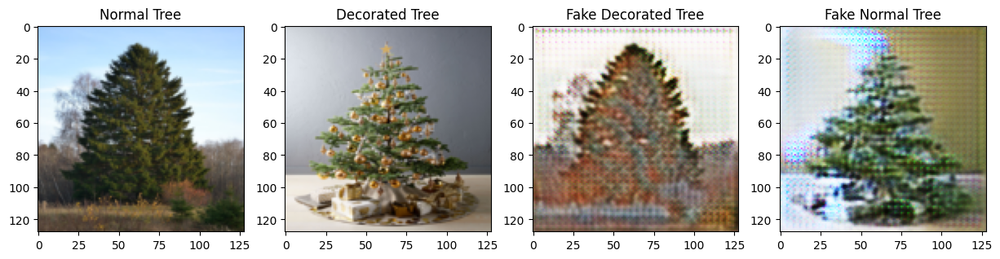

Epoch [60/300] Loss G: 111.9345, Loss D_x: 0.1494, Loss D_y: 0.2289
Epoch [61/300] Loss G: 110.4896, Loss D_x: 0.1130, Loss D_y: 0.1854
Epoch [62/300] Loss G: 113.1360, Loss D_x: 0.1080, Loss D_y: 0.1364
Epoch [63/300] Loss G: 115.1365, Loss D_x: 0.1129, Loss D_y: 0.1773
Epoch [64/300] Loss G: 109.6250, Loss D_x: 0.1541, Loss D_y: 0.1412
Epoch [65/300] Loss G: 111.5816, Loss D_x: 0.1257, Loss D_y: 0.1149
Epoch [66/300] Loss G: 110.4689, Loss D_x: 0.2352, Loss D_y: 0.1161
Epoch [67/300] Loss G: 108.0490, Loss D_x: 0.1212, Loss D_y: 0.1053
Epoch [68/300] Loss G: 106.0271, Loss D_x: 0.1297, Loss D_y: 0.2034
Epoch [69/300] Loss G: 104.4080, Loss D_x: 0.1039, Loss D_y: 0.0966


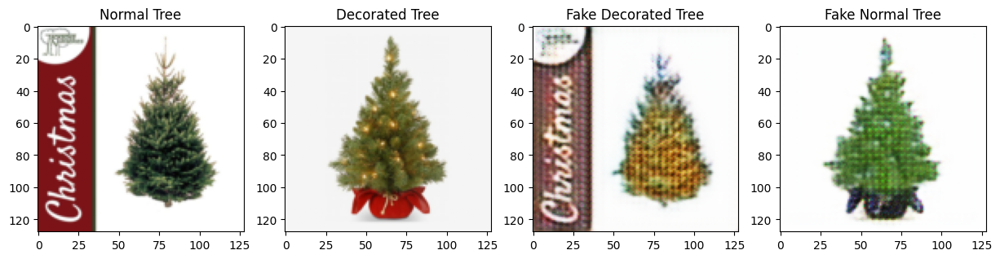

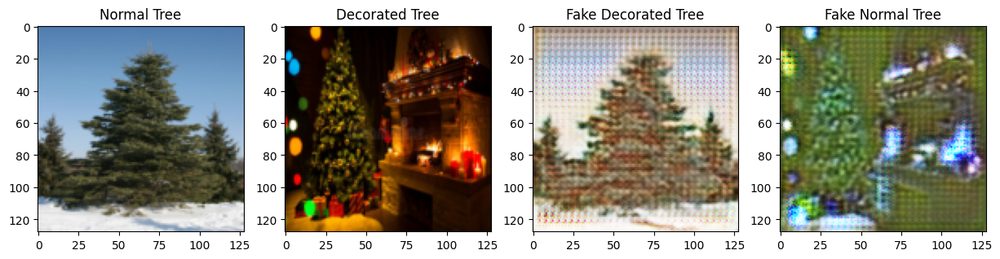

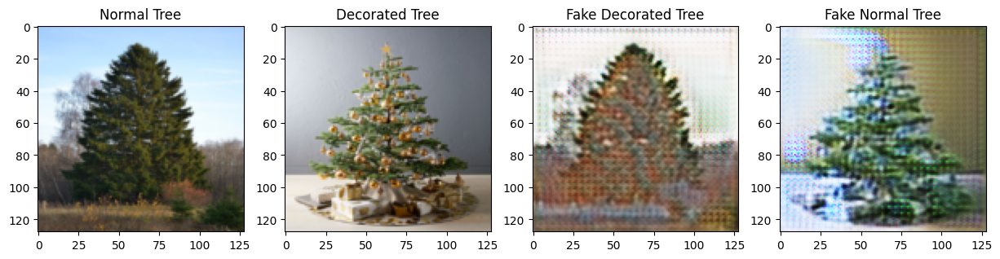

Epoch [70/300] Loss G: 105.2314, Loss D_x: 0.1538, Loss D_y: 0.1242
Epoch [71/300] Loss G: 106.2528, Loss D_x: 0.7766, Loss D_y: 0.1116
Epoch [72/300] Loss G: 104.8290, Loss D_x: 30.4439, Loss D_y: 0.1340
Epoch [73/300] Loss G: 102.4027, Loss D_x: 1.8389, Loss D_y: 0.0871
Epoch [74/300] Loss G: 101.2481, Loss D_x: 0.4248, Loss D_y: 0.1516
Epoch [75/300] Loss G: 102.0498, Loss D_x: 0.3046, Loss D_y: 0.1398
Epoch [76/300] Loss G: 105.9184, Loss D_x: 0.2213, Loss D_y: 0.1773
Epoch [77/300] Loss G: 103.1092, Loss D_x: 0.1768, Loss D_y: 0.0593
Epoch [78/300] Loss G: 104.5892, Loss D_x: 0.1442, Loss D_y: 0.0918
Epoch [79/300] Loss G: 101.3364, Loss D_x: 0.1274, Loss D_y: 0.0904


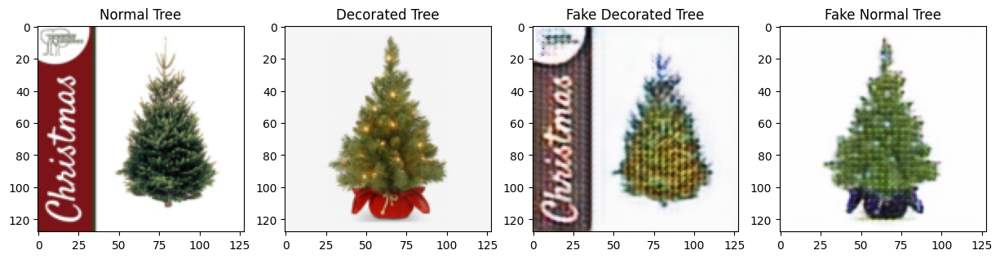

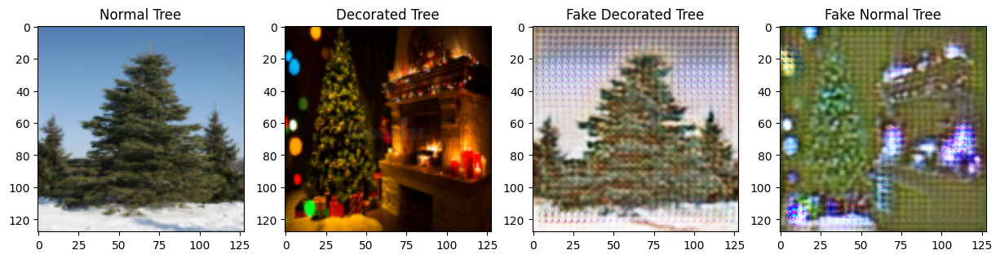

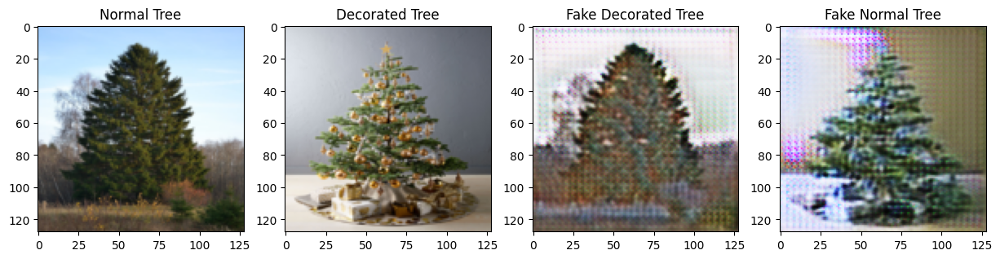

Epoch [80/300] Loss G: 99.7294, Loss D_x: 0.1291, Loss D_y: 0.0795
Epoch [81/300] Loss G: 98.1045, Loss D_x: 0.1088, Loss D_y: 0.2248
Epoch [82/300] Loss G: 98.4405, Loss D_x: 0.0988, Loss D_y: 0.1178
Epoch [83/300] Loss G: 96.1711, Loss D_x: 0.0889, Loss D_y: 0.0537
Epoch [84/300] Loss G: 97.3008, Loss D_x: 0.0826, Loss D_y: 0.0937
Epoch [85/300] Loss G: 94.8063, Loss D_x: 0.0918, Loss D_y: 0.1905
Epoch [86/300] Loss G: 94.4091, Loss D_x: 0.0907, Loss D_y: 0.1168
Epoch [87/300] Loss G: 96.3346, Loss D_x: 0.0714, Loss D_y: 0.0642
Epoch [88/300] Loss G: 94.7904, Loss D_x: 0.0699, Loss D_y: 0.1051
Epoch [89/300] Loss G: 94.1820, Loss D_x: 0.0677, Loss D_y: 0.1364


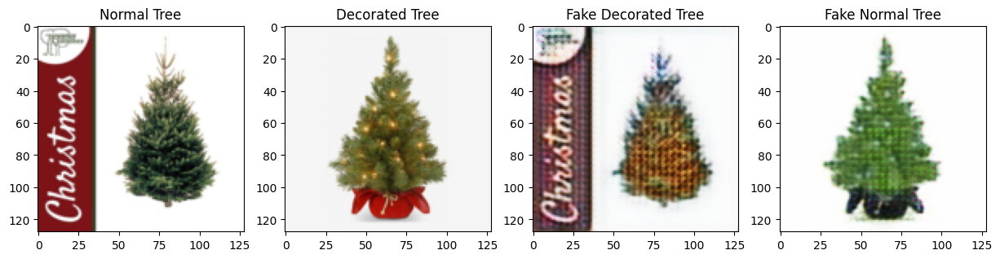

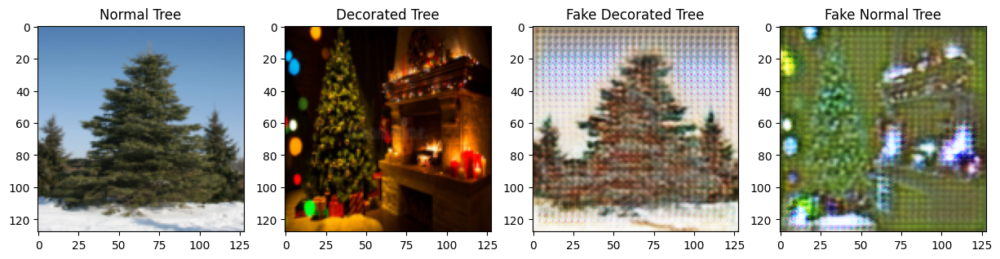

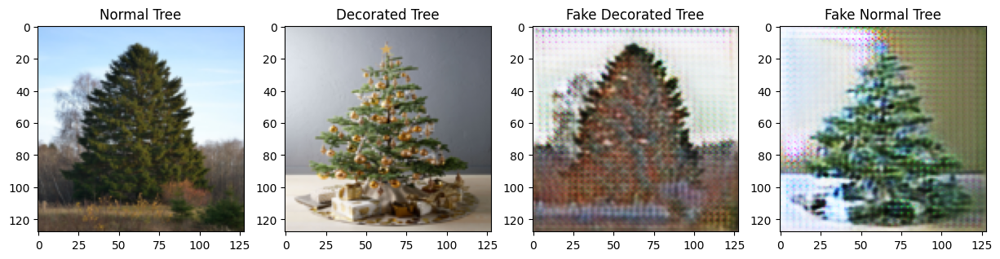

Epoch [90/300] Loss G: 94.1316, Loss D_x: 0.0646, Loss D_y: 0.1099
Epoch [91/300] Loss G: 97.9380, Loss D_x: 0.1007, Loss D_y: 0.0689
Epoch [92/300] Loss G: 95.2617, Loss D_x: 0.0599, Loss D_y: 0.1377
Epoch [93/300] Loss G: 92.6735, Loss D_x: 0.0575, Loss D_y: 0.0666
Epoch [94/300] Loss G: 93.2438, Loss D_x: 0.0614, Loss D_y: 0.1210
Epoch [95/300] Loss G: 92.7277, Loss D_x: 0.0570, Loss D_y: 0.1280
Epoch [96/300] Loss G: 89.8793, Loss D_x: 0.0523, Loss D_y: 0.0997
Epoch [97/300] Loss G: 90.5595, Loss D_x: 0.0479, Loss D_y: 0.1438
Epoch [98/300] Loss G: 95.1563, Loss D_x: 0.0607, Loss D_y: 0.0899
Epoch [99/300] Loss G: 90.4675, Loss D_x: 0.1014, Loss D_y: 0.0707


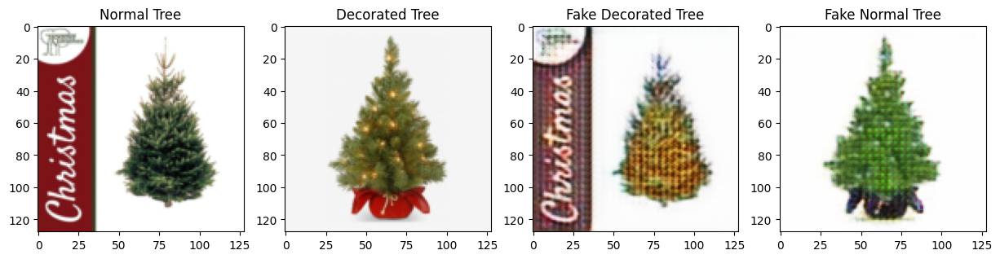

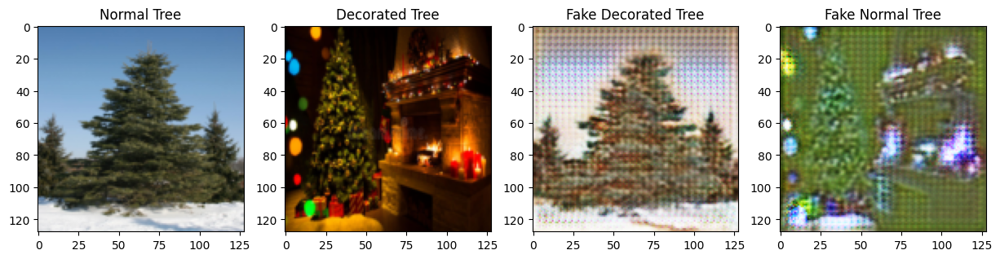

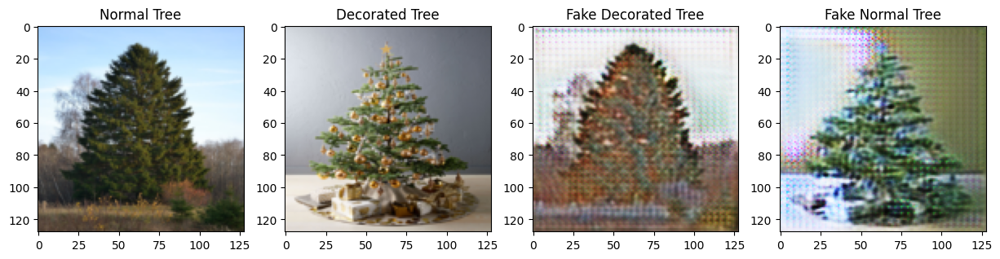

Epoch [100/300] Loss G: 91.5926, Loss D_x: 0.0515, Loss D_y: 0.1107
Epoch [101/300] Loss G: 91.6928, Loss D_x: 0.0452, Loss D_y: 0.1222
Epoch [102/300] Loss G: 90.6864, Loss D_x: 0.0423, Loss D_y: 0.1143
Epoch [103/300] Loss G: 91.0927, Loss D_x: 0.0575, Loss D_y: 0.1182
Epoch [104/300] Loss G: 89.7230, Loss D_x: 0.0538, Loss D_y: 0.0439
Epoch [105/300] Loss G: 100.0398, Loss D_x: 0.0491, Loss D_y: 8.5539
Epoch [106/300] Loss G: 89.7463, Loss D_x: 0.0696, Loss D_y: 0.2058
Epoch [107/300] Loss G: 86.7226, Loss D_x: 0.0387, Loss D_y: 0.1283
Epoch [108/300] Loss G: 88.7291, Loss D_x: 0.0507, Loss D_y: 0.0855
Epoch [109/300] Loss G: 85.3719, Loss D_x: 0.0390, Loss D_y: 0.0703


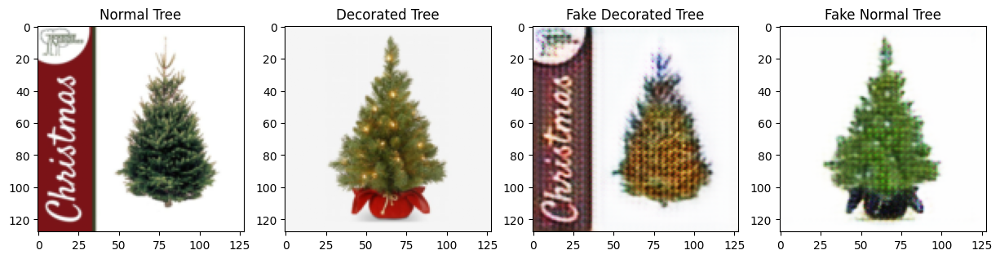

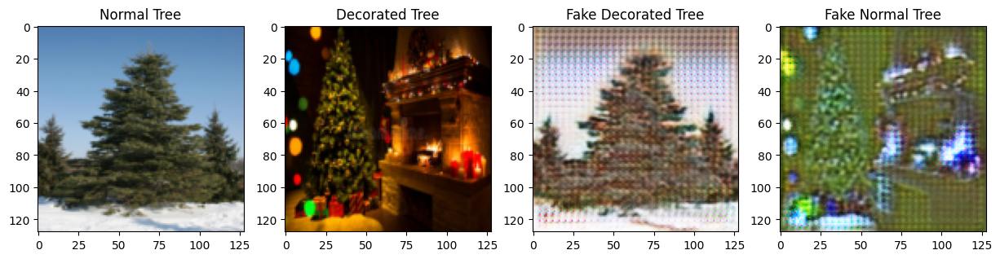

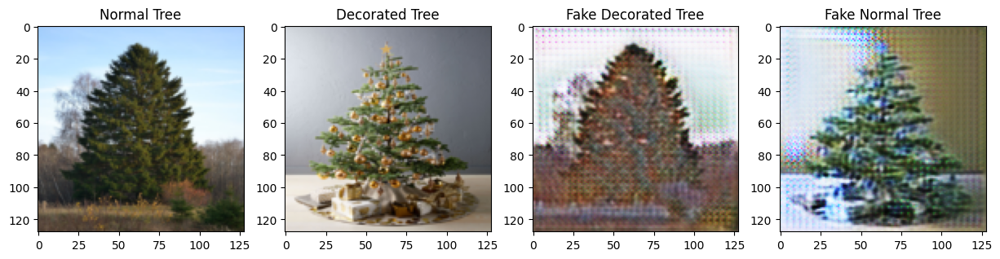

Epoch [110/300] Loss G: 85.7208, Loss D_x: 0.0493, Loss D_y: 0.0616
Epoch [111/300] Loss G: 87.3129, Loss D_x: 0.0525, Loss D_y: 0.0533
Epoch [112/300] Loss G: 86.1519, Loss D_x: 0.0539, Loss D_y: 0.0492
Epoch [113/300] Loss G: 89.7987, Loss D_x: 0.0715, Loss D_y: 0.0457
Epoch [114/300] Loss G: 86.8298, Loss D_x: 0.0402, Loss D_y: 0.0408
Epoch [115/300] Loss G: 86.1257, Loss D_x: 0.0809, Loss D_y: 0.0400
Epoch [116/300] Loss G: 84.4694, Loss D_x: 0.0604, Loss D_y: 0.0371
Epoch [117/300] Loss G: 84.9685, Loss D_x: 0.0344, Loss D_y: 0.0330
Epoch [118/300] Loss G: 87.0605, Loss D_x: 0.0417, Loss D_y: 0.0309
Epoch [119/300] Loss G: 83.3919, Loss D_x: 0.0574, Loss D_y: 0.0303


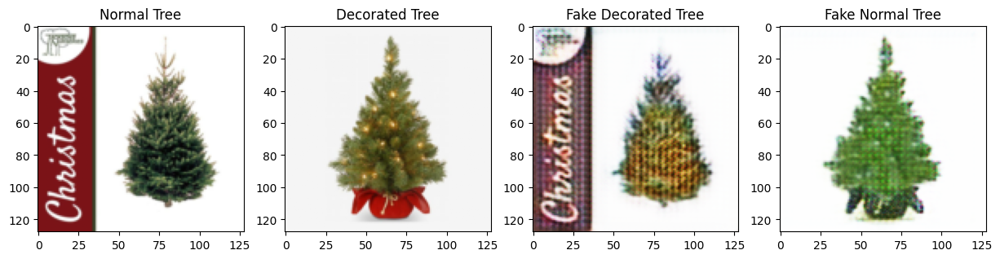

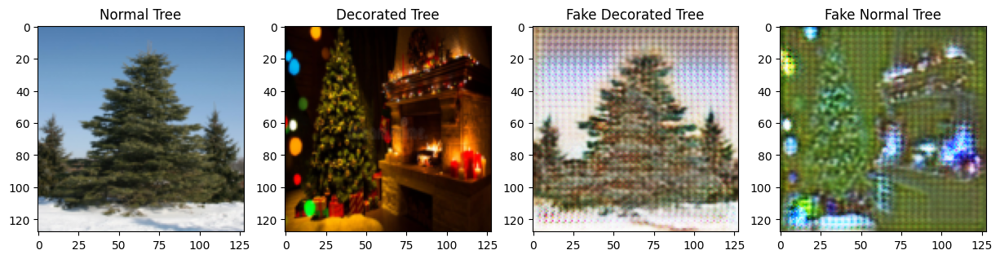

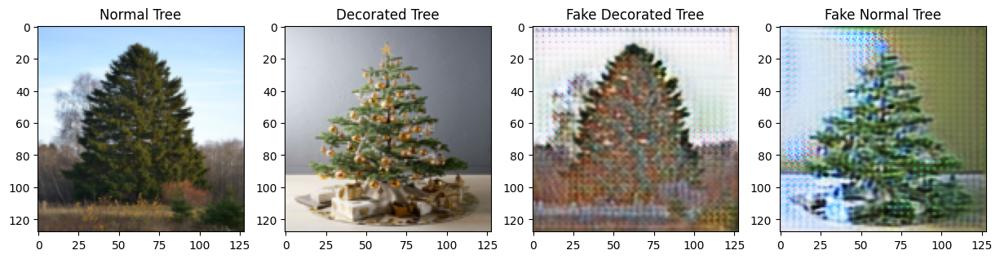

Epoch [120/300] Loss G: 84.5561, Loss D_x: 0.0557, Loss D_y: 0.0264
Epoch [121/300] Loss G: 84.8025, Loss D_x: 0.0759, Loss D_y: 0.0351
Epoch [122/300] Loss G: 83.3582, Loss D_x: 0.0435, Loss D_y: 0.0348
Epoch [123/300] Loss G: 81.8478, Loss D_x: 0.0681, Loss D_y: 0.0319
Epoch [124/300] Loss G: 82.9828, Loss D_x: 0.0668, Loss D_y: 0.0287
Epoch [125/300] Loss G: 81.2549, Loss D_x: 0.0669, Loss D_y: 0.0448
Epoch [126/300] Loss G: 81.9612, Loss D_x: 0.0631, Loss D_y: 0.0316
Epoch [127/300] Loss G: 83.0399, Loss D_x: 0.0432, Loss D_y: 0.0311
Epoch [128/300] Loss G: 83.6400, Loss D_x: 0.0385, Loss D_y: 0.0254
Epoch [129/300] Loss G: 82.0823, Loss D_x: 0.0420, Loss D_y: 0.0278


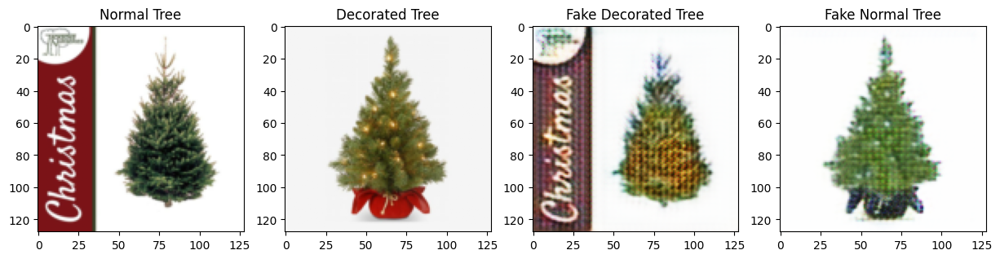

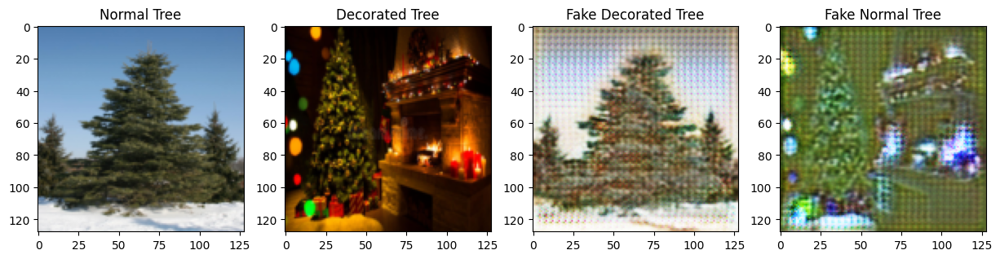

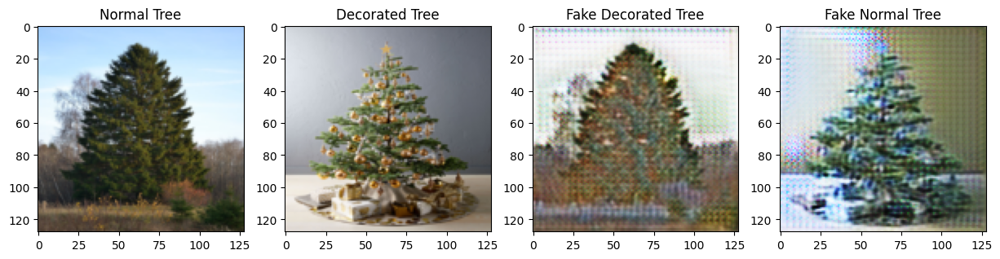

Epoch [130/300] Loss G: 80.3656, Loss D_x: 0.0863, Loss D_y: 0.0525
Epoch [131/300] Loss G: 79.8331, Loss D_x: 0.0617, Loss D_y: 0.0291
Epoch [132/300] Loss G: 79.3132, Loss D_x: 0.0735, Loss D_y: 0.0320
Epoch [133/300] Loss G: 78.7589, Loss D_x: 0.0546, Loss D_y: 0.0280
Epoch [134/300] Loss G: 84.4892, Loss D_x: 0.0728, Loss D_y: 0.0398
Epoch [135/300] Loss G: 82.2747, Loss D_x: 0.0882, Loss D_y: 0.0630
Epoch [136/300] Loss G: 82.0322, Loss D_x: 0.0605, Loss D_y: 0.0381
Epoch [137/300] Loss G: 78.8149, Loss D_x: 0.0638, Loss D_y: 0.0384
Epoch [138/300] Loss G: 78.6978, Loss D_x: 0.0590, Loss D_y: 0.0577
Epoch [139/300] Loss G: 79.9307, Loss D_x: 0.0755, Loss D_y: 0.0555


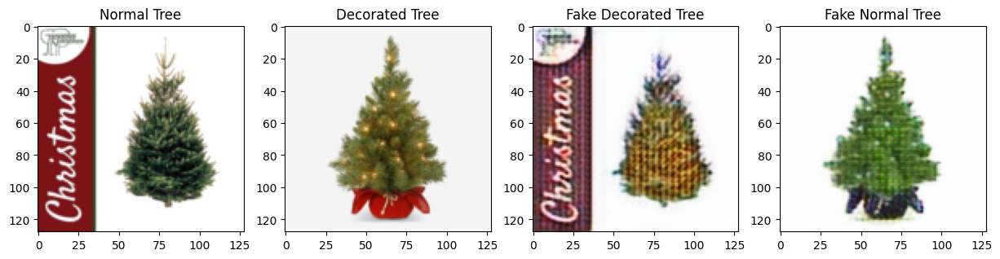

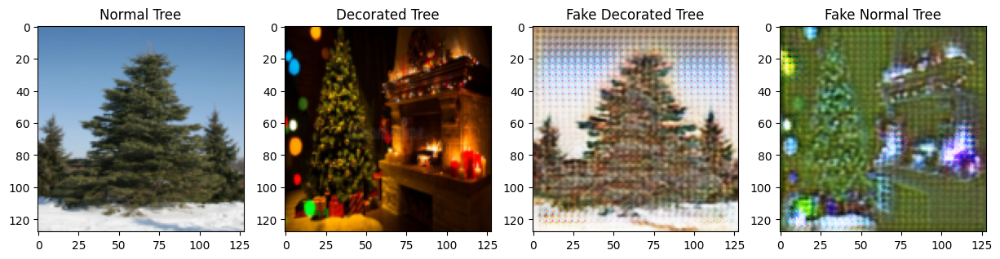

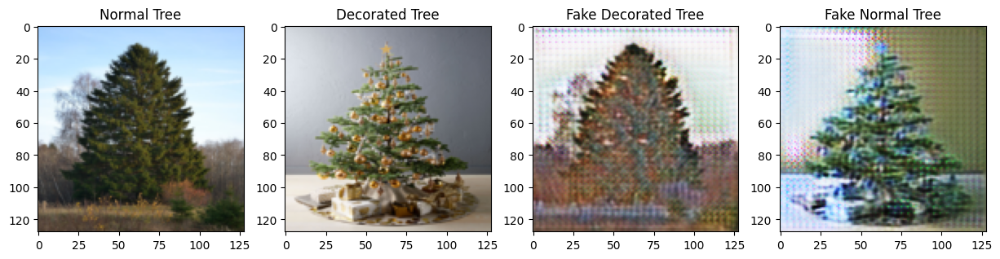

Epoch [140/300] Loss G: 78.9203, Loss D_x: 0.0543, Loss D_y: 0.0732
Epoch [141/300] Loss G: 77.1288, Loss D_x: 0.0784, Loss D_y: 0.0358
Epoch [142/300] Loss G: 77.2601, Loss D_x: 0.1062, Loss D_y: 0.0633
Epoch [143/300] Loss G: 75.5032, Loss D_x: 0.0491, Loss D_y: 0.0419
Epoch [144/300] Loss G: 79.8199, Loss D_x: 0.0355, Loss D_y: 0.0755
Epoch [145/300] Loss G: 80.4237, Loss D_x: 0.0504, Loss D_y: 0.0678
Epoch [146/300] Loss G: 78.2928, Loss D_x: 0.1210, Loss D_y: 0.0384
Epoch [147/300] Loss G: 76.2440, Loss D_x: 0.0612, Loss D_y: 0.0309
Epoch [148/300] Loss G: 77.8326, Loss D_x: 0.0498, Loss D_y: 0.1013
Epoch [149/300] Loss G: 76.3810, Loss D_x: 3.9279, Loss D_y: 0.0751


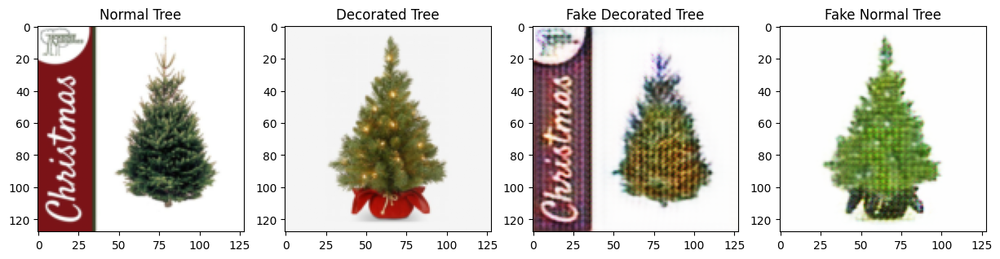

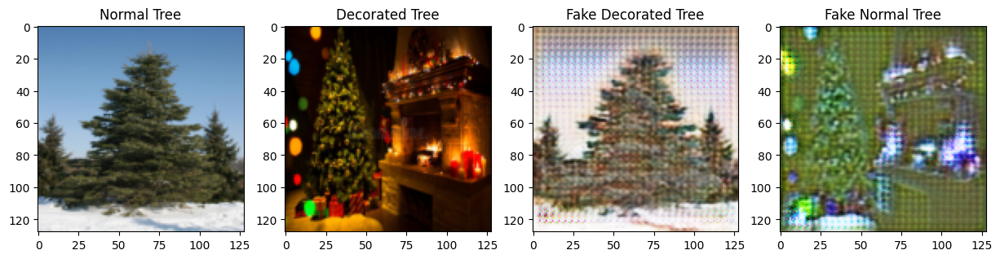

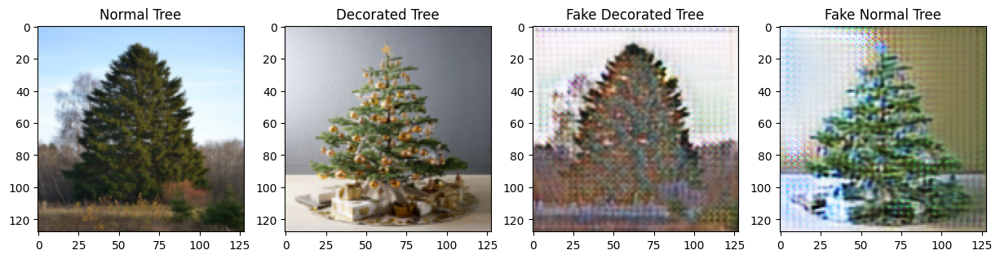

Epoch [150/300] Loss G: 75.7122, Loss D_x: 6.4212, Loss D_y: 0.0711
Epoch [151/300] Loss G: 75.0288, Loss D_x: 0.1271, Loss D_y: 0.0511
Epoch [152/300] Loss G: 74.6740, Loss D_x: 0.0855, Loss D_y: 0.0515
Epoch [153/300] Loss G: 74.7413, Loss D_x: 0.0606, Loss D_y: 0.0706
Epoch [154/300] Loss G: 74.3888, Loss D_x: 0.0514, Loss D_y: 0.0791
Epoch [155/300] Loss G: 75.5330, Loss D_x: 0.0421, Loss D_y: 0.0598
Epoch [156/300] Loss G: 75.0862, Loss D_x: 0.0359, Loss D_y: 0.1098
Epoch [157/300] Loss G: 74.0131, Loss D_x: 0.0322, Loss D_y: 0.0316
Epoch [158/300] Loss G: 76.6185, Loss D_x: 0.0298, Loss D_y: 0.1021
Epoch [159/300] Loss G: 74.9608, Loss D_x: 0.0272, Loss D_y: 0.0399


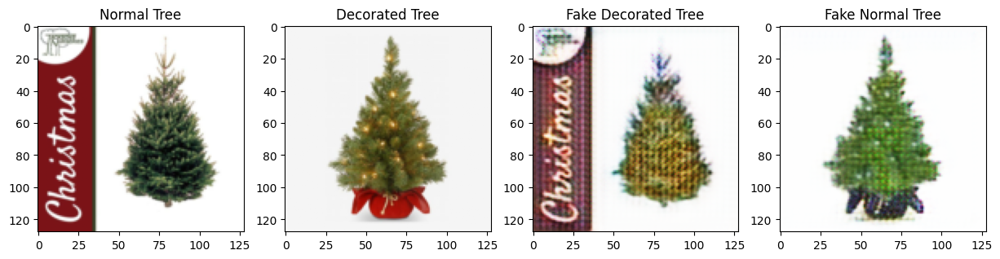

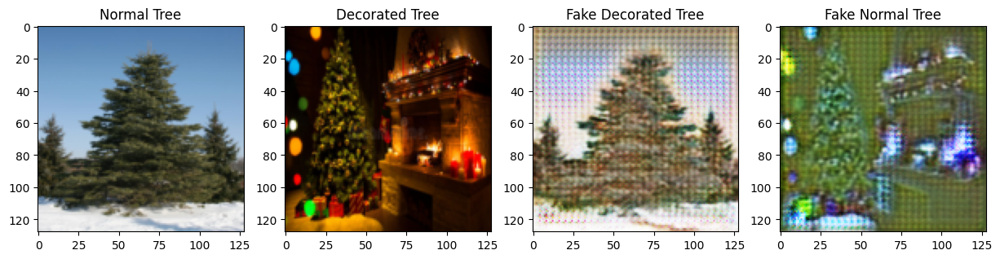

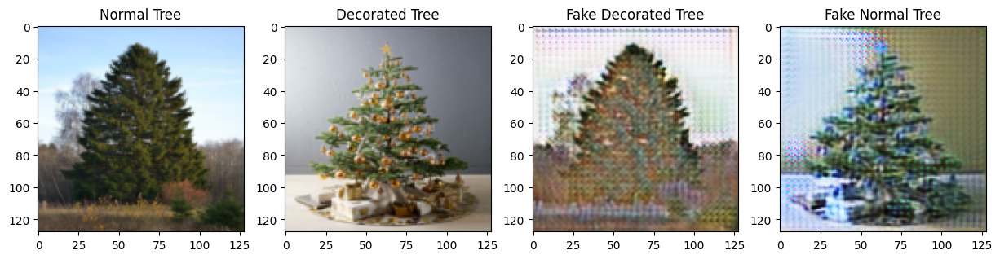

Epoch [160/300] Loss G: 74.4987, Loss D_x: 0.0236, Loss D_y: 0.0500
Epoch [161/300] Loss G: 75.1212, Loss D_x: 0.0224, Loss D_y: 0.0790
Epoch [162/300] Loss G: 78.4263, Loss D_x: 0.0229, Loss D_y: 0.8548
Epoch [163/300] Loss G: 74.8134, Loss D_x: 0.0195, Loss D_y: 0.0250
Epoch [164/300] Loss G: 74.4754, Loss D_x: 0.0178, Loss D_y: 0.0171
Epoch [165/300] Loss G: 74.0219, Loss D_x: 0.0173, Loss D_y: 0.0156
Epoch [166/300] Loss G: 73.0004, Loss D_x: 0.0173, Loss D_y: 0.0149
Epoch [167/300] Loss G: 72.2696, Loss D_x: 0.0171, Loss D_y: 0.0212
Epoch [168/300] Loss G: 73.4217, Loss D_x: 0.0159, Loss D_y: 0.0138
Epoch [169/300] Loss G: 73.1757, Loss D_x: 0.0277, Loss D_y: 0.0366


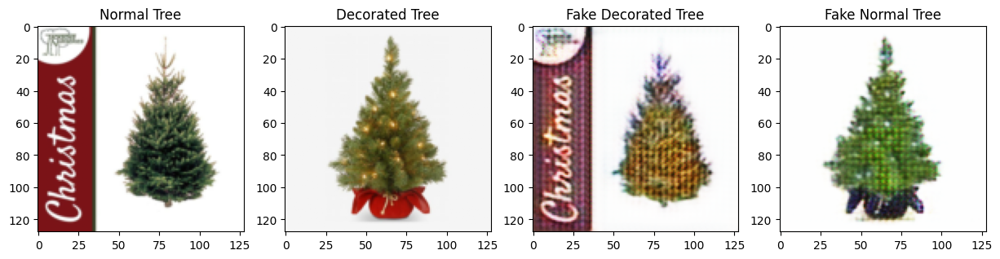

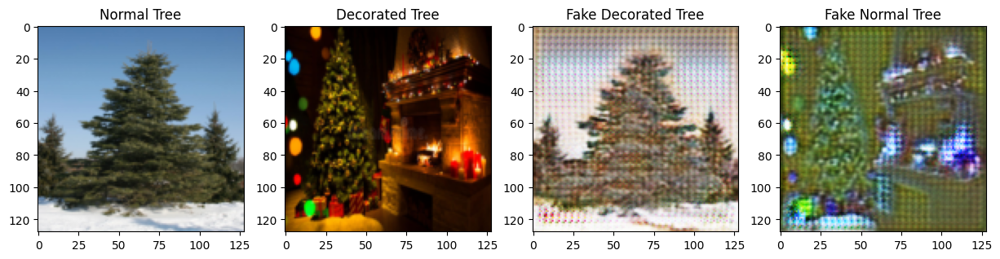

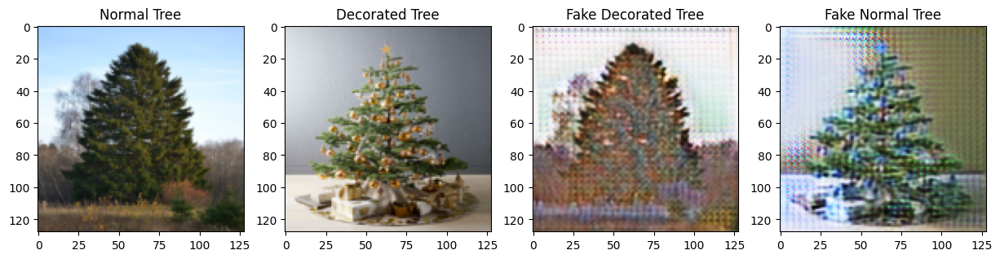

Epoch [170/300] Loss G: 72.1604, Loss D_x: 0.0162, Loss D_y: 0.0172
Epoch [171/300] Loss G: 72.3683, Loss D_x: 0.0334, Loss D_y: 0.0311
Epoch [172/300] Loss G: 72.4928, Loss D_x: 0.0148, Loss D_y: 0.0246
Epoch [173/300] Loss G: 71.1677, Loss D_x: 0.0406, Loss D_y: 0.0226
Epoch [174/300] Loss G: 72.3891, Loss D_x: 0.0216, Loss D_y: 0.0451
Epoch [175/300] Loss G: 72.9919, Loss D_x: 0.0357, Loss D_y: 0.0418
Epoch [176/300] Loss G: 70.5131, Loss D_x: 0.0169, Loss D_y: 0.0492
Epoch [177/300] Loss G: 70.7526, Loss D_x: 0.0228, Loss D_y: 0.0662
Epoch [178/300] Loss G: 70.6156, Loss D_x: 0.0273, Loss D_y: 0.0728
Epoch [179/300] Loss G: 70.3760, Loss D_x: 0.0407, Loss D_y: 0.0161


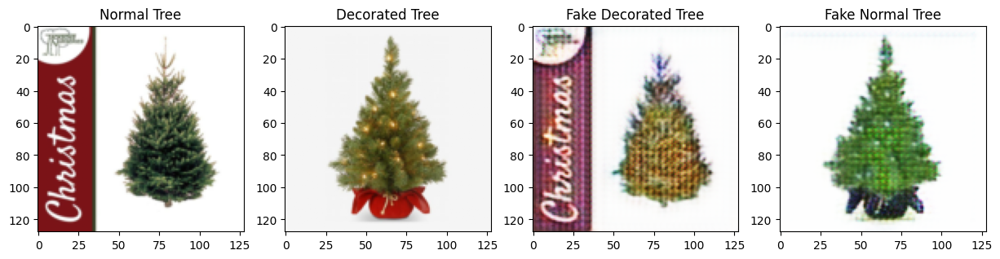

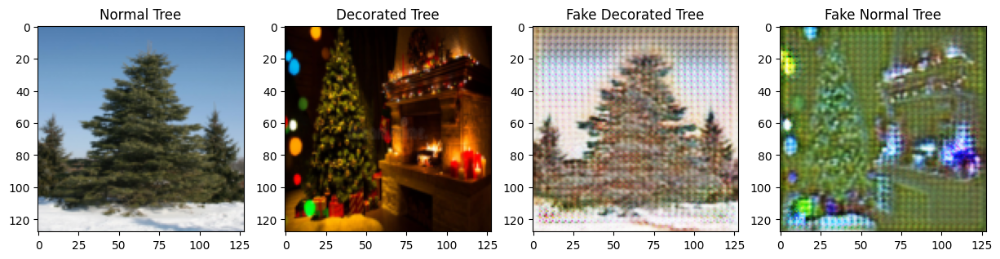

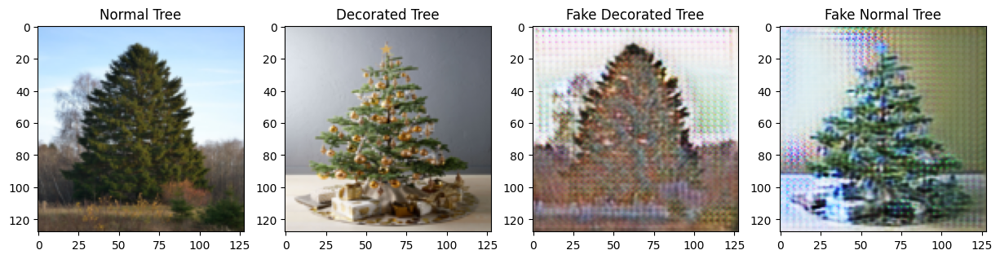

Epoch [180/300] Loss G: 70.3668, Loss D_x: 0.0204, Loss D_y: 0.0436
Epoch [181/300] Loss G: 73.5574, Loss D_x: 0.0574, Loss D_y: 0.1044
Epoch [182/300] Loss G: 73.4075, Loss D_x: 0.0130, Loss D_y: 0.0481
Epoch [183/300] Loss G: 70.1056, Loss D_x: 0.0191, Loss D_y: 0.0328
Epoch [184/300] Loss G: 69.2535, Loss D_x: 0.0287, Loss D_y: 0.0392
Epoch [185/300] Loss G: 69.3751, Loss D_x: 0.0298, Loss D_y: 0.0473
Epoch [186/300] Loss G: 69.1350, Loss D_x: 0.0283, Loss D_y: 0.0506
Epoch [187/300] Loss G: 68.0312, Loss D_x: 0.0233, Loss D_y: 0.1007
Epoch [188/300] Loss G: 68.5607, Loss D_x: 0.0365, Loss D_y: 0.0426
Epoch [189/300] Loss G: 68.8025, Loss D_x: 0.0352, Loss D_y: 0.0644


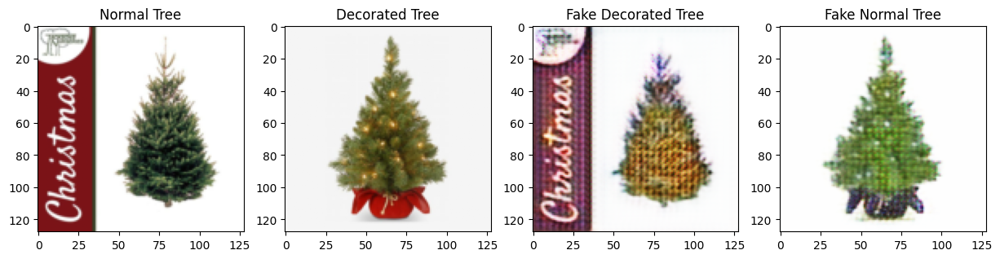

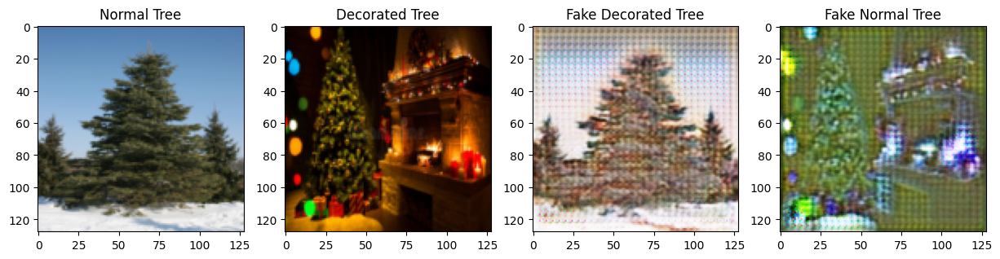

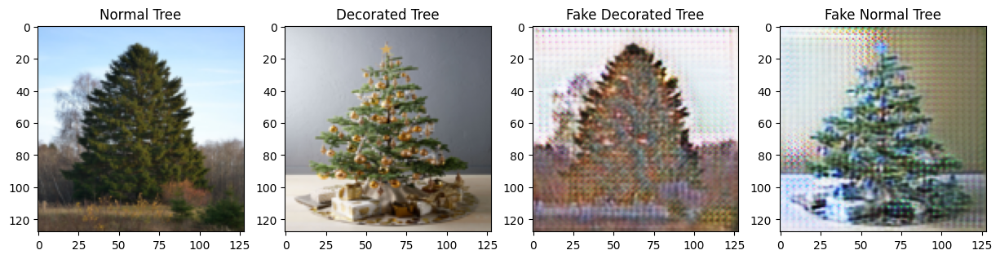

Epoch [190/300] Loss G: 69.8571, Loss D_x: 0.0405, Loss D_y: 0.0369
Epoch [191/300] Loss G: 68.5023, Loss D_x: 0.0212, Loss D_y: 0.0280
Epoch [192/300] Loss G: 70.2816, Loss D_x: 0.0347, Loss D_y: 0.0605
Epoch [193/300] Loss G: 70.0661, Loss D_x: 0.0371, Loss D_y: 0.0738
Epoch [194/300] Loss G: 71.2092, Loss D_x: 0.0326, Loss D_y: 0.0250
Epoch [195/300] Loss G: 76.3102, Loss D_x: 0.0473, Loss D_y: 0.0540
Epoch [196/300] Loss G: 70.6284, Loss D_x: 0.0318, Loss D_y: 0.0966
Epoch [197/300] Loss G: 68.4317, Loss D_x: 0.0370, Loss D_y: 0.0252
Epoch [198/300] Loss G: 66.7939, Loss D_x: 0.0315, Loss D_y: 0.0508
Epoch [199/300] Loss G: 67.3177, Loss D_x: 0.0552, Loss D_y: 0.0390


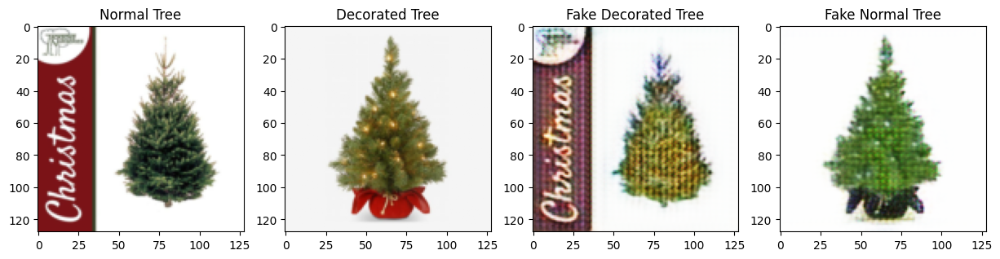

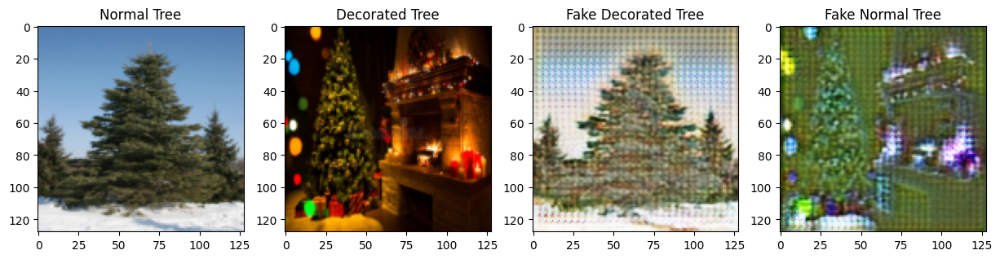

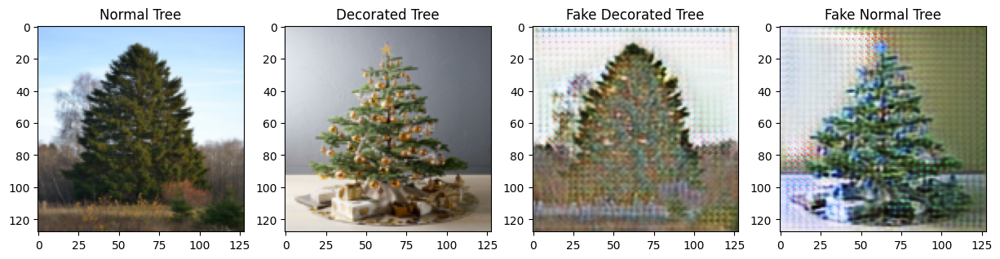

Epoch [200/300] Loss G: 67.6492, Loss D_x: 0.0231, Loss D_y: 0.0480
Epoch [201/300] Loss G: 66.3438, Loss D_x: 0.0392, Loss D_y: 0.0632
Epoch [202/300] Loss G: 66.6942, Loss D_x: 0.0360, Loss D_y: 0.0277
Epoch [203/300] Loss G: 64.8131, Loss D_x: 0.0455, Loss D_y: 0.0409
Epoch [204/300] Loss G: 68.8370, Loss D_x: 0.0360, Loss D_y: 0.0553
Epoch [205/300] Loss G: 66.5015, Loss D_x: 0.0375, Loss D_y: 0.0647
Epoch [206/300] Loss G: 66.0969, Loss D_x: 0.0233, Loss D_y: 0.0303
Epoch [207/300] Loss G: 72.7041, Loss D_x: 0.0550, Loss D_y: 0.0571
Epoch [208/300] Loss G: 71.2523, Loss D_x: 0.0340, Loss D_y: 0.0404
Epoch [209/300] Loss G: 67.6127, Loss D_x: 0.0386, Loss D_y: 0.0627


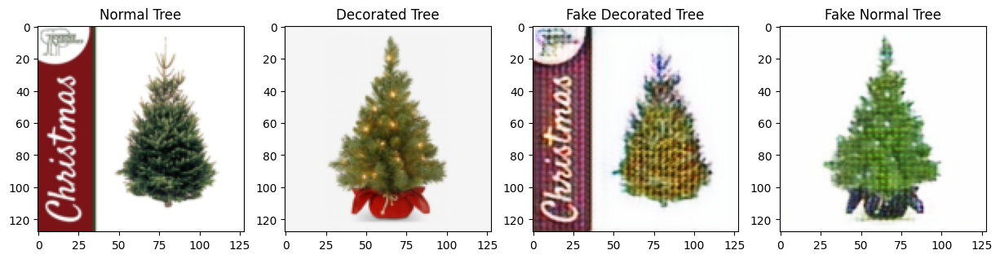

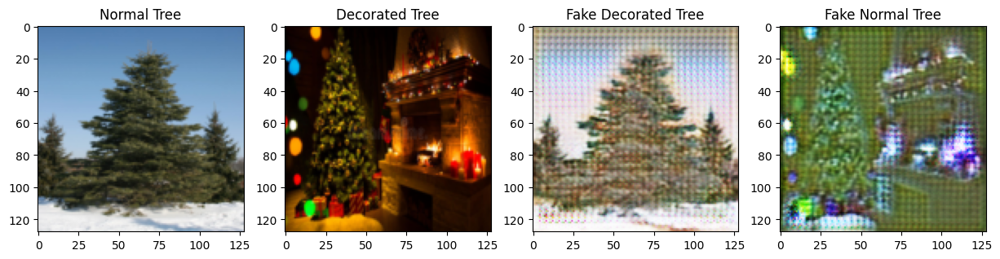

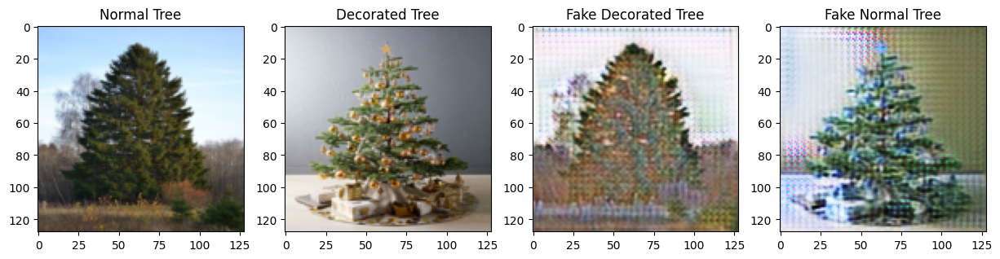

Epoch [210/300] Loss G: 68.4821, Loss D_x: 0.0432, Loss D_y: 0.0316
Epoch [211/300] Loss G: 64.7489, Loss D_x: 0.0309, Loss D_y: 0.0263
Epoch [212/300] Loss G: 64.7428, Loss D_x: 0.0394, Loss D_y: 0.0883
Epoch [213/300] Loss G: 66.2120, Loss D_x: 0.0440, Loss D_y: 0.0350
Epoch [214/300] Loss G: 66.5332, Loss D_x: 0.0451, Loss D_y: 0.0422
Epoch [215/300] Loss G: 67.2199, Loss D_x: 0.0478, Loss D_y: 0.0475
Epoch [216/300] Loss G: 64.4477, Loss D_x: 0.0196, Loss D_y: 0.0189
Epoch [217/300] Loss G: 63.2882, Loss D_x: 0.0467, Loss D_y: 0.0650
Epoch [218/300] Loss G: 63.6961, Loss D_x: 0.0529, Loss D_y: 0.0455
Epoch [219/300] Loss G: 65.2295, Loss D_x: 0.0369, Loss D_y: 0.0306


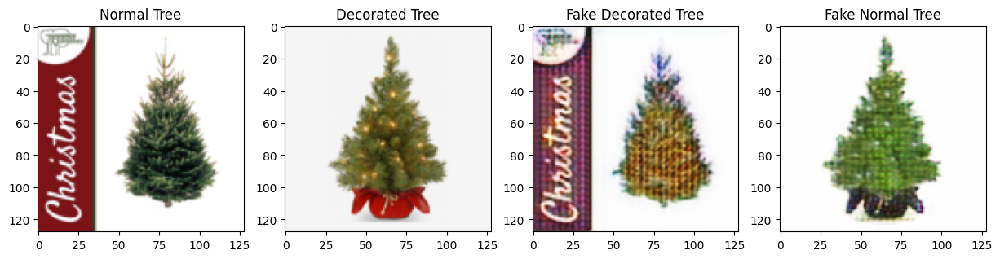

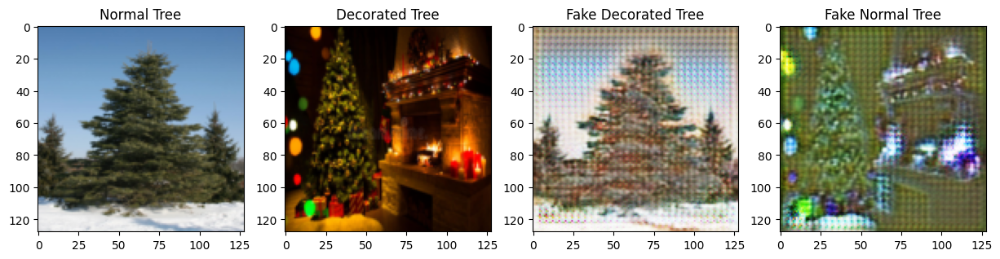

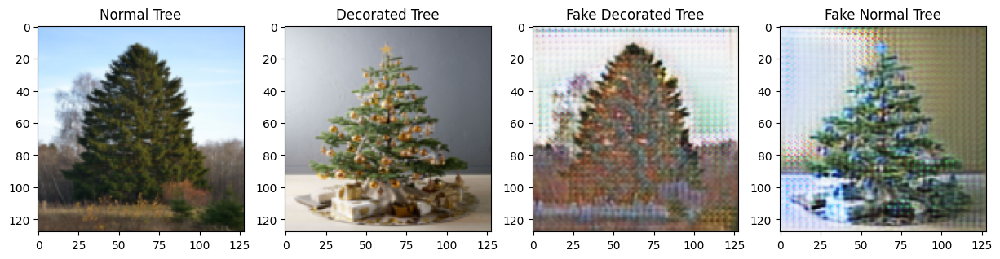

Epoch [220/300] Loss G: 64.4500, Loss D_x: 0.0261, Loss D_y: 0.0678
Epoch [221/300] Loss G: 63.0962, Loss D_x: 0.0497, Loss D_y: 0.0330
Epoch [222/300] Loss G: 62.9970, Loss D_x: 0.0389, Loss D_y: 0.0516
Epoch [223/300] Loss G: 65.1022, Loss D_x: 0.0617, Loss D_y: 0.0304
Epoch [224/300] Loss G: 64.4855, Loss D_x: 0.0248, Loss D_y: 0.0664
Epoch [225/300] Loss G: 63.8768, Loss D_x: 0.0534, Loss D_y: 0.0313
Epoch [226/300] Loss G: 64.1935, Loss D_x: 0.0187, Loss D_y: 0.0130
Epoch [227/300] Loss G: 64.7532, Loss D_x: 0.0295, Loss D_y: 0.1344
Epoch [228/300] Loss G: 62.9217, Loss D_x: 0.0725, Loss D_y: 0.0232
Epoch [229/300] Loss G: 64.0194, Loss D_x: 0.0244, Loss D_y: 0.0162


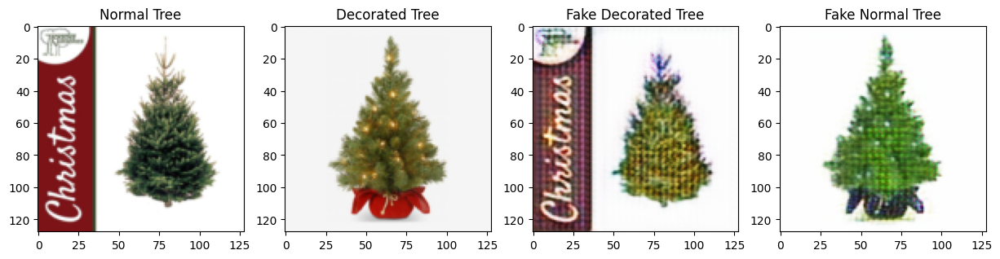

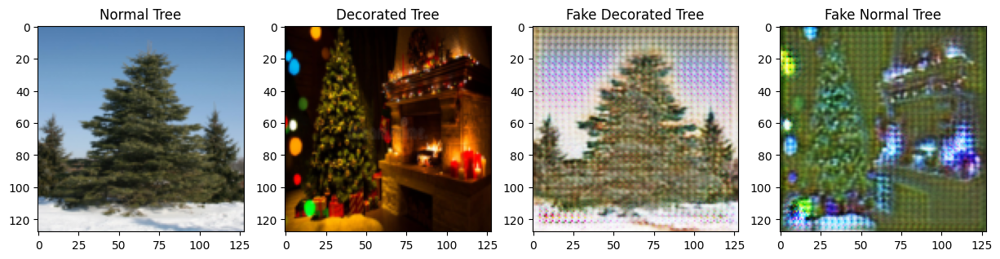

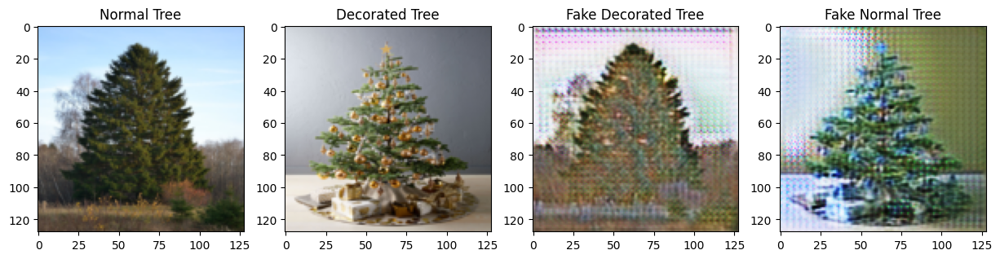

Epoch [230/300] Loss G: 63.2852, Loss D_x: 0.0374, Loss D_y: 0.0149
Epoch [231/300] Loss G: 66.3420, Loss D_x: 0.0705, Loss D_y: 0.0616
Epoch [232/300] Loss G: 62.9453, Loss D_x: 0.0127, Loss D_y: 0.0396
Epoch [233/300] Loss G: 63.6071, Loss D_x: 0.0425, Loss D_y: 0.0384
Epoch [234/300] Loss G: 62.8510, Loss D_x: 0.0489, Loss D_y: 0.0456
Epoch [235/300] Loss G: 65.2910, Loss D_x: 0.0193, Loss D_y: 0.0498
Epoch [236/300] Loss G: 65.7701, Loss D_x: 4.1861, Loss D_y: 0.0335
Epoch [237/300] Loss G: 62.3876, Loss D_x: 0.0592, Loss D_y: 0.0308
Epoch [238/300] Loss G: 60.8154, Loss D_x: 0.0323, Loss D_y: 0.0770
Epoch [239/300] Loss G: 64.5507, Loss D_x: 0.0222, Loss D_y: 0.0126


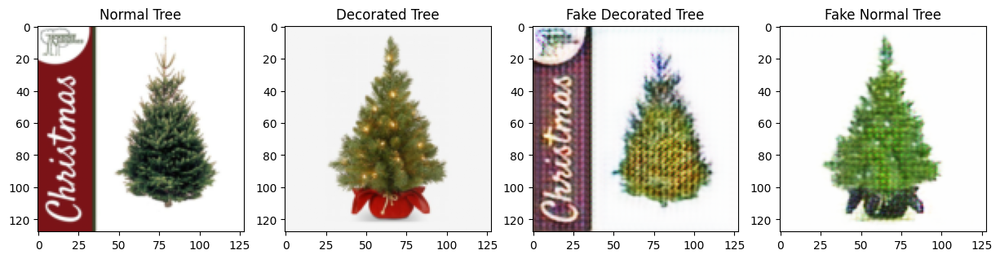

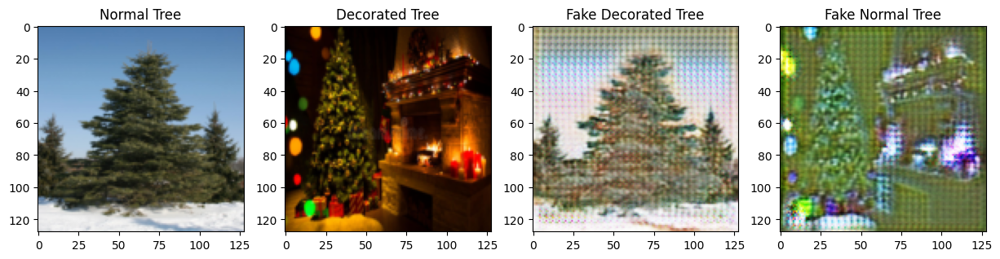

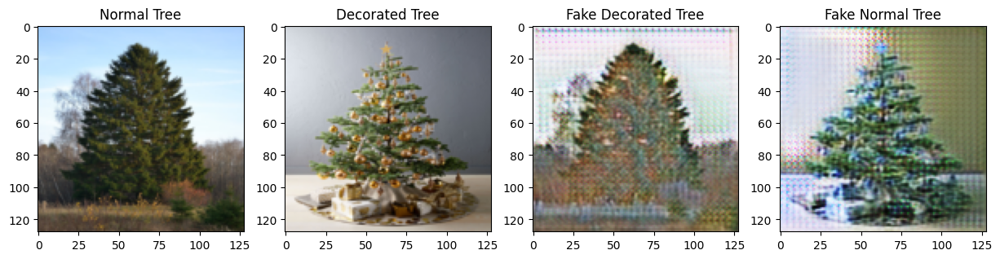

Epoch [240/300] Loss G: 63.8216, Loss D_x: 0.0172, Loss D_y: 0.0229
Epoch [241/300] Loss G: 67.7555, Loss D_x: 0.0146, Loss D_y: 5.6072
Epoch [242/300] Loss G: 60.9939, Loss D_x: 0.0114, Loss D_y: 0.0967
Epoch [243/300] Loss G: 60.2275, Loss D_x: 0.0103, Loss D_y: 0.0439
Epoch [244/300] Loss G: 61.2058, Loss D_x: 0.0094, Loss D_y: 0.0300
Epoch [245/300] Loss G: 62.5137, Loss D_x: 0.0094, Loss D_y: 0.0224
Epoch [246/300] Loss G: 62.2558, Loss D_x: 0.0081, Loss D_y: 0.0178
Epoch [247/300] Loss G: 62.6055, Loss D_x: 0.0071, Loss D_y: 0.0149
Epoch [248/300] Loss G: 60.7303, Loss D_x: 0.0073, Loss D_y: 0.0146
Epoch [249/300] Loss G: 62.5415, Loss D_x: 0.0069, Loss D_y: 0.0122


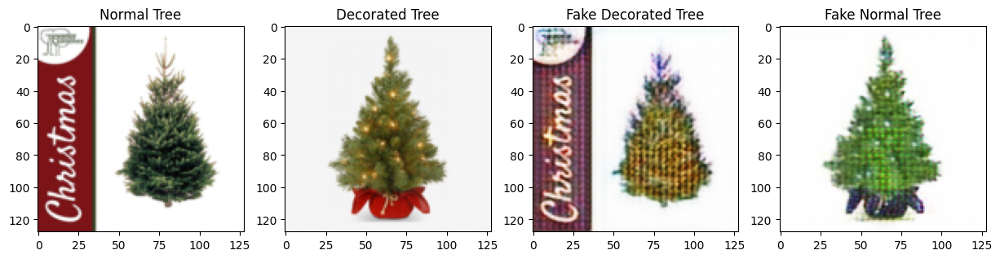

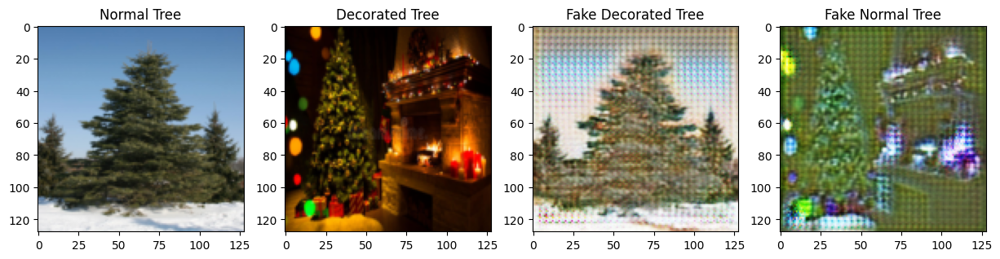

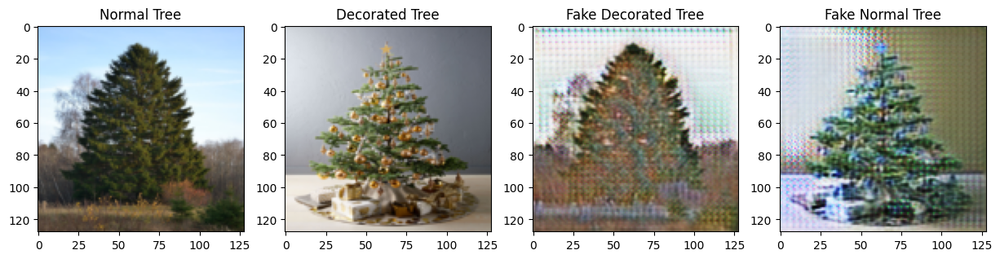

Epoch [250/300] Loss G: 62.0342, Loss D_x: 0.0060, Loss D_y: 0.0101
Epoch [251/300] Loss G: 62.1670, Loss D_x: 0.0059, Loss D_y: 0.0094
Epoch [252/300] Loss G: 60.7903, Loss D_x: 0.0058, Loss D_y: 0.0083
Epoch [253/300] Loss G: 59.5629, Loss D_x: 0.0053, Loss D_y: 0.0083
Epoch [254/300] Loss G: 59.7565, Loss D_x: 0.0055, Loss D_y: 0.0074
Epoch [255/300] Loss G: 62.1874, Loss D_x: 0.0094, Loss D_y: 0.0077
Epoch [256/300] Loss G: 62.6428, Loss D_x: 0.0187, Loss D_y: 0.0065
Epoch [257/300] Loss G: 59.0887, Loss D_x: 0.0114, Loss D_y: 0.0066
Epoch [258/300] Loss G: 60.3993, Loss D_x: 0.0217, Loss D_y: 0.0060
Epoch [259/300] Loss G: 61.8882, Loss D_x: 0.0233, Loss D_y: 0.0058


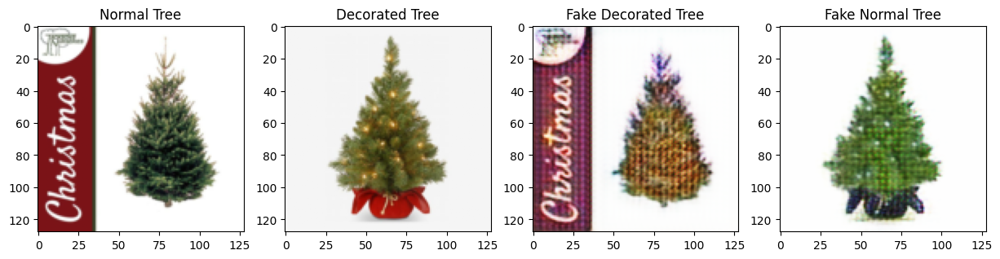

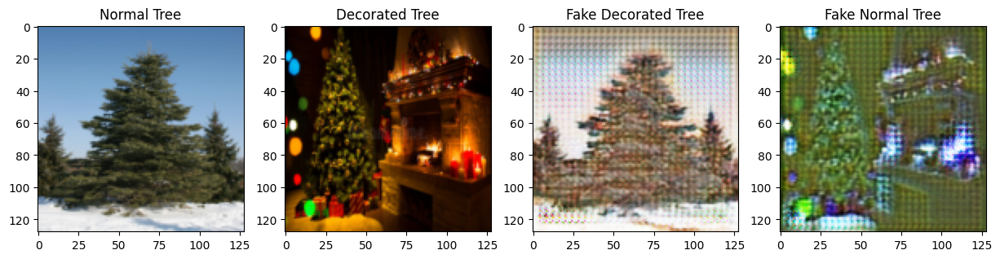

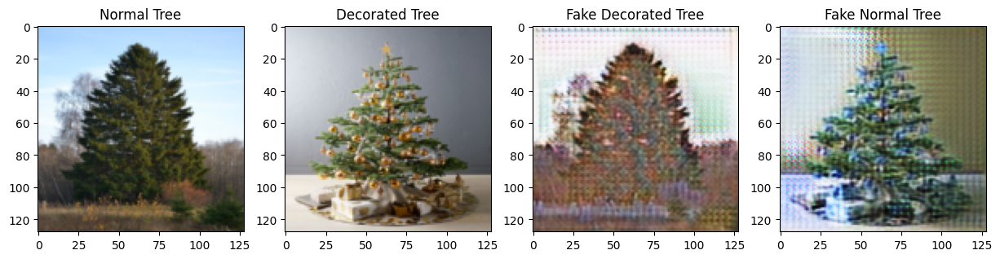

Epoch [260/300] Loss G: 59.0322, Loss D_x: 0.0129, Loss D_y: 0.0051
Epoch [261/300] Loss G: 58.1194, Loss D_x: 0.0237, Loss D_y: 0.0050
Epoch [262/300] Loss G: 57.7254, Loss D_x: 0.0284, Loss D_y: 0.0054
Epoch [263/300] Loss G: 58.5450, Loss D_x: 0.0185, Loss D_y: 0.0061
Epoch [264/300] Loss G: 59.8547, Loss D_x: 0.0084, Loss D_y: 0.0053
Epoch [265/300] Loss G: 61.0272, Loss D_x: 0.0495, Loss D_y: 0.0048
Epoch [266/300] Loss G: 58.8617, Loss D_x: 0.0064, Loss D_y: 0.0083
Epoch [267/300] Loss G: 59.9030, Loss D_x: 0.0473, Loss D_y: 0.0060
Epoch [268/300] Loss G: 60.9097, Loss D_x: 0.0119, Loss D_y: 0.0315
Epoch [269/300] Loss G: 59.2732, Loss D_x: 0.0118, Loss D_y: 0.0077


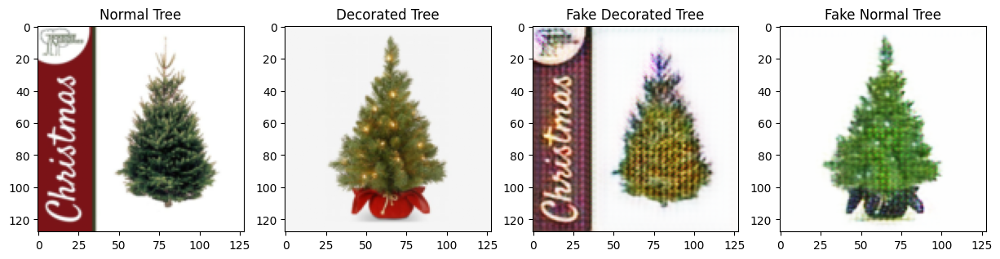

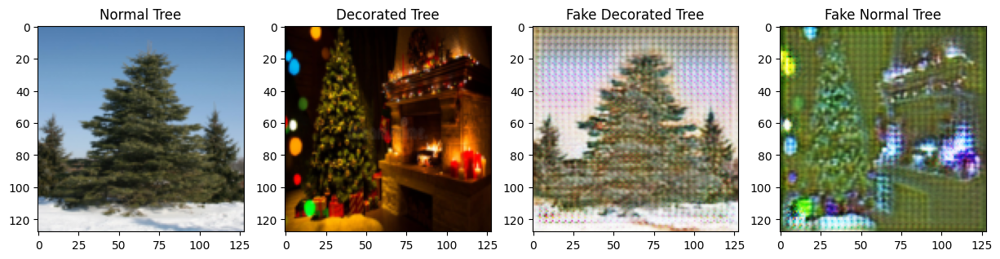

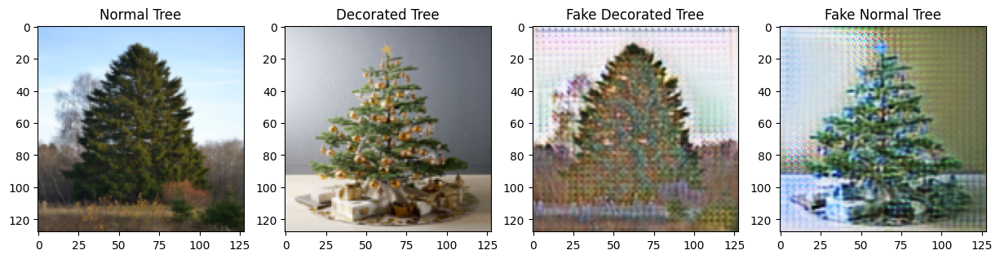

Epoch [270/300] Loss G: 60.1243, Loss D_x: 0.0432, Loss D_y: 0.0177
Epoch [271/300] Loss G: 59.8484, Loss D_x: 0.0147, Loss D_y: 0.0298
Epoch [272/300] Loss G: 60.1637, Loss D_x: 0.0405, Loss D_y: 0.0136
Epoch [273/300] Loss G: 59.3435, Loss D_x: 0.0275, Loss D_y: 0.0278
Epoch [274/300] Loss G: 59.7877, Loss D_x: 0.0206, Loss D_y: 0.0088
Epoch [275/300] Loss G: 60.1389, Loss D_x: 0.0128, Loss D_y: 0.0322
Epoch [276/300] Loss G: 58.3628, Loss D_x: 0.0679, Loss D_y: 0.0287
Epoch [277/300] Loss G: 58.8950, Loss D_x: 0.0129, Loss D_y: 0.0192
Epoch [278/300] Loss G: 57.1698, Loss D_x: 0.0090, Loss D_y: 0.0223
Epoch [279/300] Loss G: 59.5738, Loss D_x: 0.0413, Loss D_y: 0.0215


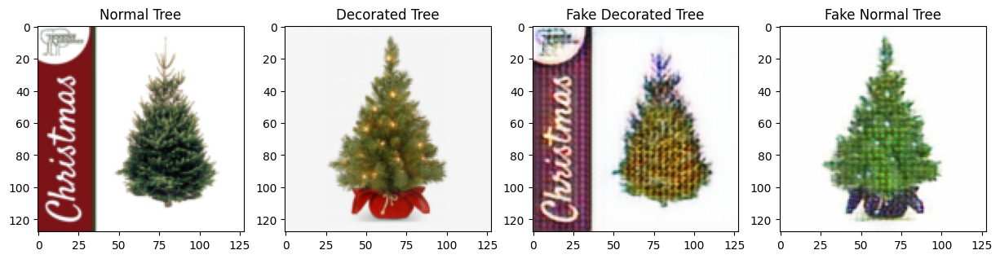

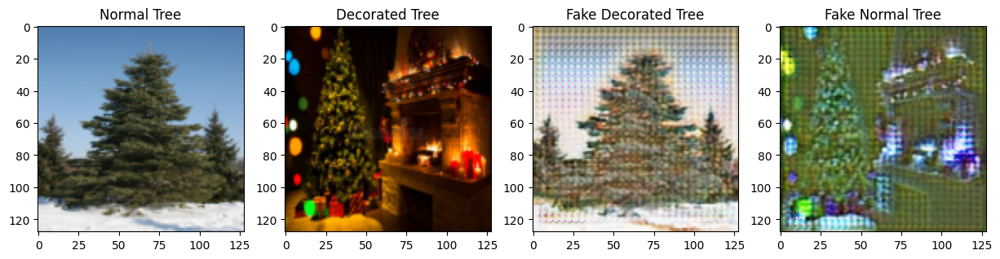

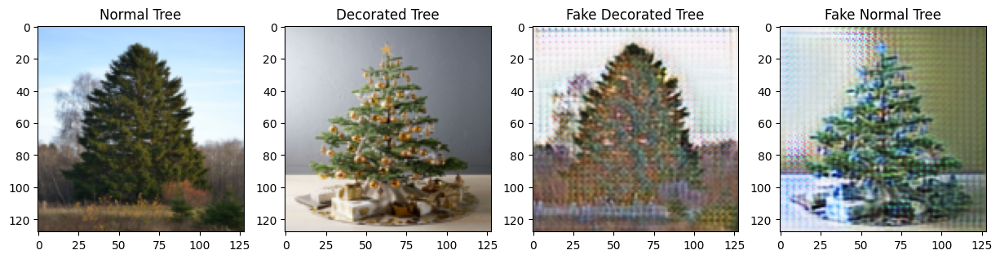

Epoch [280/300] Loss G: 56.9567, Loss D_x: 0.0441, Loss D_y: 0.0355
Epoch [281/300] Loss G: 56.3458, Loss D_x: 0.0219, Loss D_y: 0.0220
Epoch [282/300] Loss G: 56.8770, Loss D_x: 0.0427, Loss D_y: 0.0300
Epoch [283/300] Loss G: 58.5533, Loss D_x: 0.0307, Loss D_y: 0.0119
Epoch [284/300] Loss G: 59.1162, Loss D_x: 0.0490, Loss D_y: 0.0419
Epoch [285/300] Loss G: 58.1349, Loss D_x: 0.0092, Loss D_y: 0.0293
Epoch [286/300] Loss G: 58.0554, Loss D_x: 0.0589, Loss D_y: 0.0297
Epoch [287/300] Loss G: 57.2114, Loss D_x: 0.0146, Loss D_y: 0.0219
Epoch [288/300] Loss G: 57.0977, Loss D_x: 0.0365, Loss D_y: 0.0272
Epoch [289/300] Loss G: 57.2375, Loss D_x: 0.0383, Loss D_y: 0.0347


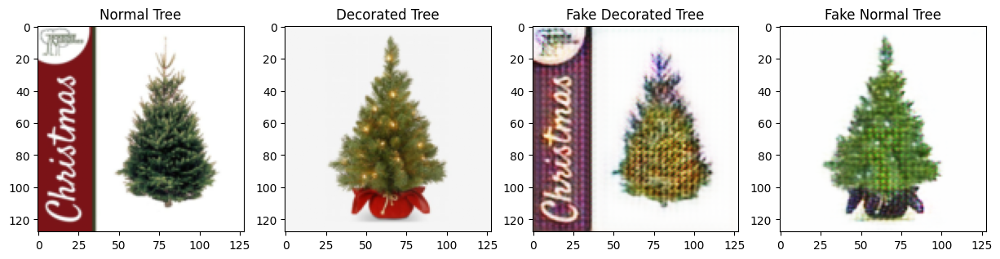

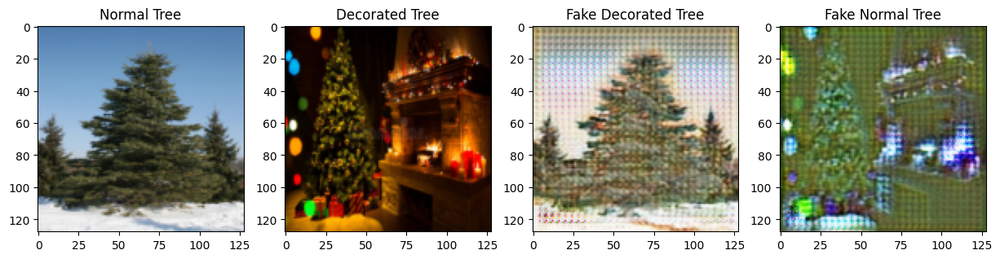

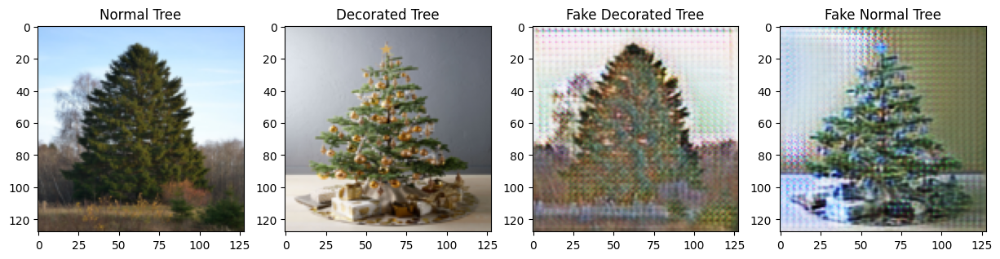

Epoch [290/300] Loss G: 56.3292, Loss D_x: 0.0386, Loss D_y: 0.0130
Epoch [291/300] Loss G: 56.0272, Loss D_x: 0.0206, Loss D_y: 0.0582
Epoch [292/300] Loss G: 56.1827, Loss D_x: 0.0428, Loss D_y: 0.0238
Epoch [293/300] Loss G: 56.5975, Loss D_x: 0.0265, Loss D_y: 0.0309
Epoch [294/300] Loss G: 58.8591, Loss D_x: 0.0254, Loss D_y: 0.0435
Epoch [295/300] Loss G: 57.4310, Loss D_x: 0.0502, Loss D_y: 0.0103
Epoch [296/300] Loss G: 56.1047, Loss D_x: 0.0103, Loss D_y: 0.0405
Epoch [297/300] Loss G: 58.2727, Loss D_x: 0.0564, Loss D_y: 0.0500
Epoch [298/300] Loss G: 59.2692, Loss D_x: 0.0128, Loss D_y: 0.0156
Epoch [299/300] Loss G: 56.6606, Loss D_x: 0.0489, Loss D_y: 0.0482


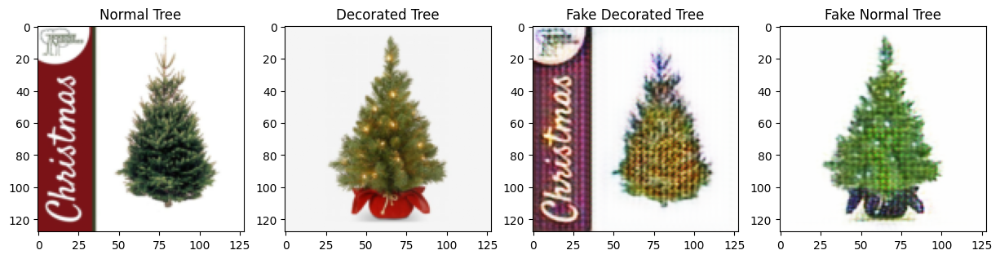

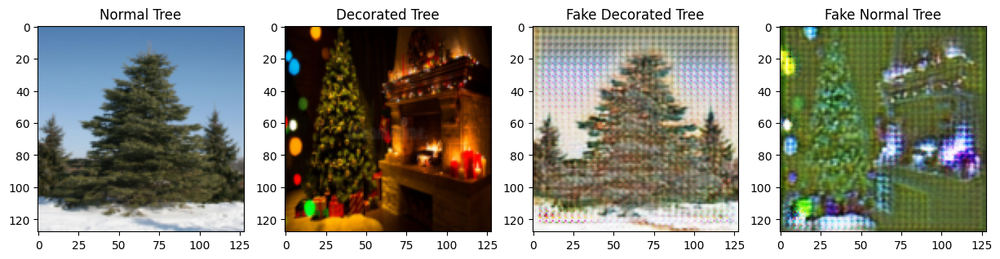

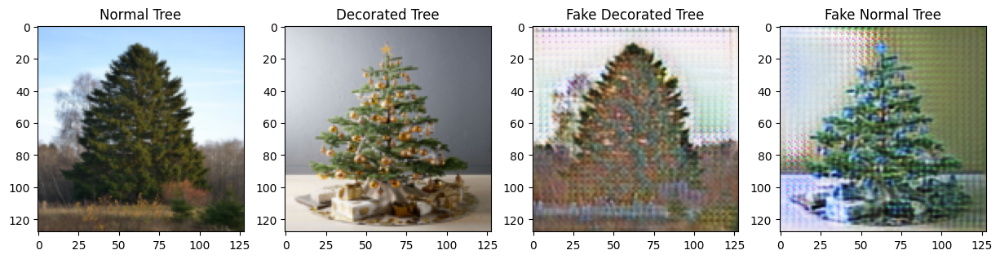

Epoch [300/300] Loss G: 55.9169, Loss D_x: 0.0312, Loss D_y: 0.0126


In [6]:
# Parameters
batch_size = 4
image_size = 128
num_epochs = 300
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Paths to the dataset directories
normal_tree_dir = "/kaggle/input/christmas-trees/undecorated"  # Replace with your path
decorated_tree_dir = "/kaggle/input/christmas-trees/decorated"  # Replace with your path

# Transformations for the dataset
transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
])

# Dataset Preparation
normal_images = sorted(os.listdir(normal_tree_dir))
decorated_images = sorted(os.listdir(decorated_tree_dir))

# Ensure datasets have the same length (to avoid imbalance issues)
min_dataset_size = min(len(normal_images), len(decorated_images))

normal_indices = list(range(len(normal_images)))[:min_dataset_size]
decorated_indices = list(range(len(decorated_images)))[:min_dataset_size]

# Train-validation split
train_indices, val_indices = train_test_split(
    normal_indices, test_size=0.2, random_state=42
)

# Create dataset objects
train_dataset = TreeDataset(
    normal_dir=normal_tree_dir,
    decorated_dir=decorated_tree_dir,
    indices=train_indices,
    transform=transform,
)

val_dataset = TreeDataset(
    normal_dir=normal_tree_dir,
    decorated_dir=decorated_tree_dir,
    indices=val_indices,
    transform=transform,
)

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True)

# Initialize CycleGAN Models
generator_g = GeneratorResNet().to(device)  # Normal → Decorated
generator_f = GeneratorResNet().to(device)  # Decorated → Normal
discriminator_x = Discriminator().to(device)  # For Decorated Trees
discriminator_y = Discriminator().to(device)  # For Normal Trees

# Training the CycleGAN
train_cyclegan(
    generator_g=generator_g,
    generator_f=generator_f,
    discriminator_x=discriminator_x,
    discriminator_y=discriminator_y,
    train_loader=train_loader,
    val_loader=val_loader,
    device=device,
    num_epochs=num_epochs,
)
